# Convolutional Neural Networks

## Project: Write an Algorithm for Landmark Classification

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all the code implementations, you need to finalize your work by exporting the Jupyter Notebook as an HTML document. Before exporting the notebook to HTML, all the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to **File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this Jupyter notebook.

---
### Why We're Here

Photo sharing and photo storage services like to have location data for each photo that is uploaded. With the location data, these services can build advanced features, such as automatic suggestion of relevant tags or automatic photo organization, which help provide a compelling user experience. Although a photo's location can often be obtained by looking at the photo's metadata, many photos uploaded to these services will not have location metadata available. This can happen when, for example, the camera capturing the picture does not have GPS or if a photo's metadata is scrubbed due to privacy concerns.

If no location metadata for an image is available, one way to infer the location is to detect and classify a discernible landmark in the image. Given the large number of landmarks across the world and the immense volume of images that are uploaded to photo sharing services, using human judgement to classify these landmarks would not be feasible.

In this notebook, you will take the first steps towards addressing this problem by building models to automatically predict the location of the image based on any landmarks depicted in the image. At the end of this project, your code will accept any user-supplied image as input and suggest the top k most relevant landmarks from 50 possible landmarks from across the world. The image below displays a potential sample output of your finished project.

![Sample landmark classification output](images/sample_landmark_output.png)


### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Download Datasets and Install Python Modules
* [Step 1](#step1): Create a CNN to Classify Landmarks (from Scratch)
* [Step 2](#step2): Create a CNN to Classify Landmarks (using Transfer Learning)
* [Step 3](#step3): Write Your Landmark Prediction Algorithm

---
<a id='step0'></a>
## Step 0: Download Datasets and Install Python Modules

**Note: if you are using the Udacity workspace, *YOU CAN SKIP THIS STEP*. The dataset can be found in the `/data` folder and all required Python modules have been installed in the workspace.**

Download the [landmark dataset](https://udacity-dlnfd.s3-us-west-1.amazonaws.com/datasets/landmark_images.zip).
Unzip the folder and place it in this project's home directory, at the location `/landmark_images`.

Install the following Python modules:
* cv2
* matplotlib
* numpy
* PIL
* torch
* torchvision

---

<a id='step1'></a>
## Step 1: Create a CNN to Classify Landmarks (from Scratch)

In this step, you will create a CNN that classifies landmarks.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 20%.

Although 20% may seem low at first glance, it seems more reasonable after realizing how difficult of a problem this is. Many times, an image that is taken at a landmark captures a fairly mundane image of an animal or plant, like in the following picture.

<img src="images/train/00.Haleakala_National_Park/084c2aa50d0a9249.jpg" alt="Bird in Haleakalā National Park" style="width: 400px;"/>

Just by looking at that image alone, would you have been able to guess that it was taken at the Haleakalā National Park in Hawaii?

An accuracy of 20% is significantly better than random guessing, which would provide an accuracy of just 2%. In Step 2 of this notebook, you will have the opportunity to greatly improve accuracy by using transfer learning to create a CNN.

Remember that practice is far ahead of theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun!

### (IMPLEMENTATION) Specify Data Loaders for the Landmark Dataset

Use the code cell below to create three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader): one for training data, one for validation data, and one for test data. Randomly split the images located at `landmark_images/train` to create the train and validation data loaders, and use the images located at `landmark_images/test` to create the test data loader.

All three of your data loaders should be accessible via a dictionary named `loaders_scratch`. Your train data loader should be at `loaders_scratch['train']`, your validation data loader should be at `loaders_scratch['valid']`, and your test data loader should be at `loaders_scratch['test']`.

You may find [this documentation on custom datasets](https://pytorch.org/docs/stable/torchvision/datasets.html#datasetfolder) to be a useful resource.  If you are interested in augmenting your training and/or validation data, check out the wide variety of [transforms](http://pytorch.org/docs/stable/torchvision/transforms.html?highlight=transform)!

In [4]:
### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes
import torch
from torch.utils.data.dataloader import DataLoader
from torchvision.datasets import ImageFolder
from torchvision import transforms
import numpy as np
from torch.utils.data.sampler import SubsetRandomSampler


data_transform_train = transforms.Compose([
                                    transforms.Resize((256,256)),
                                    transforms.RandomHorizontalFlip(),
                                    transforms.RandomRotation(20),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
data_transform_val_test = transforms.Compose([
                                    transforms.Resize((256,256)),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
batch_size = 40
num_workers = 4
data_root = "./landmark_images"

train_data= ImageFolder(f'{data_root}/train',transform=data_transform_train)
test_data = ImageFolder(f'{data_root}/test',transform=data_transform_val_test)

# obtain training indices that will be used for validation
valid_size = 0.2
num_train = len(train_data)
indices = list(range(num_train))
np.random.shuffle(indices)
split = int(np.floor(valid_size * num_train))
train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

loaders_scratch = {'train': DataLoader(train_data,batch_size=batch_size,num_workers=num_workers, sampler=train_sampler),
                   'valid': DataLoader(train_data,batch_size=batch_size,num_workers=num_workers, sampler=valid_sampler),
                   'test': DataLoader(test_data,batch_size=batch_size,num_workers=num_workers, shuffle=True)
                   }


**Question 1:** Describe your chosen procedure for preprocessing the data. 
- How does your code resize the images (by cropping, stretching, etc)?  What size did you pick for the input tensor, and why?
- Did you decide to augment the dataset?  If so, how (through translations, flips, rotations, etc)?  If not, why not?

**Answer**: 
- The transformations resize the image to square of 256 x 256 pixels. this is due to easier calculations in network and also the original size would take too long to train (orig size is approx 400x600 pixels) 
- I used horizontal flip, to help better generalization and also some rotation so the network can generalize better as some images are taken verically and some horizontally. Also the normalization is used to further help the training.

### (IMPLEMENTATION) Visualize a Batch of Training Data

Use the code cell below to retrieve a batch of images from your train data loader, display at least 5 images simultaneously, and label each displayed image with its class name (e.g., "Golden Gate Bridge").

Visualizing the output of your data loader is a great way to ensure that your data loading and preprocessing are working as expected.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(40, 3, 256, 256)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

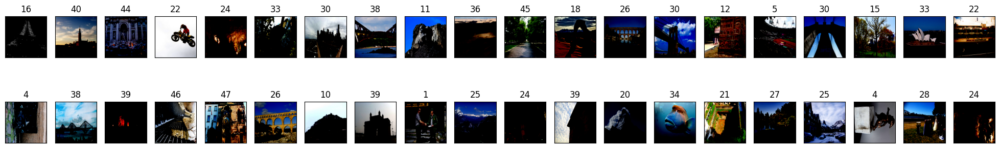

In [5]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

## TODO: visualize a batch of the train data loader

## the class names can be accessed at the `classes` attribute
## of your dataset object (e.g., `train_dataset.classes`)

dataiter = iter(loaders_scratch['test'])
images, labels = next(dataiter)
images = images.numpy()
print(images.shape)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
for idx in np.arange(batch_size):
    ax = fig.add_subplot(2, int(40/2), idx+1, xticks=[], yticks=[])
    ax.imshow(np.squeeze(images[idx].transpose((1,2,0))), cmap='gray')
    # print out the correct label for each image
    # .item() gets the value contained in a Tensor
    ax.set_title(str(labels[idx].item()))


### Initialize use_cuda variable

In [6]:
# useful variable that tells us whether we should use the GPU
use_cuda = torch.cuda.is_available()
print(use_cuda)

True


### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_scratch`, and fill in the function `get_optimizer_scratch` below.

In [7]:
import torch.nn as nn

## TODO: select loss function
criterion_scratch = nn.CrossEntropyLoss()

def get_optimizer_scratch(model):
    ## TODO: select and return an optimizer
    return torch.optim.SGD(model.parameters(), lr=0.02, momentum=0.9) 
    

    

### (IMPLEMENTATION) Model Architecture

Create a CNN to classify images of landmarks.  Use the template in the code cell below.

In [8]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
# Inspired by Cifar Excercise notebook
class Net(nn.Module):
    ## TODO: choose an architecture, and complete the class
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 16, 3, padding=1)
        self.conv2 = nn.Conv2d(16, 32, 3, padding=1)
        self.conv3 = nn.Conv2d(32, 64, 3, padding=1)
        self.conv4 = nn.Conv2d(64, 128, 3, padding=1)
        self.conv1_bn = nn.BatchNorm2d(16)
        self.conv2_bn = nn.BatchNorm2d(32)
        self.conv3_bn = nn.BatchNorm2d(64)
        self.conv4_bn = nn.BatchNorm2d(128)
        
        self.pool = nn.MaxPool2d(2, 2)
        self.fc1 = nn.Linear(128 * 16 * 16, 512)
        self.fc1_bn = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 50)
        self.dropout = nn.Dropout(0.25)

        
        
    
    def forward(self, x):
        x = self.pool(F.relu(self.conv1_bn(self.conv1(x))))
        x = self.pool(F.relu(self.conv2_bn(self.conv2(x))))
        x = self.pool(F.relu(self.conv3_bn(self.conv3(x))))
        x = self.pool(F.relu(self.conv4_bn(self.conv4(x))))

        # flatten image input
        x = x.view(-1, 128 * 16 * 16)
        x = self.dropout(x)
        x = F.relu(self.fc1_bn(self.fc1(x)))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

#-#-# Do NOT modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

__Question 2:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  

__Answer:__  
I started with the definition of the Net from previous excercise. Then I edited the values so the Net can take bigger images. i also Used Batch Normalization, per feedback from first assignment.

### (IMPLEMENTATION) Implement the Training Algorithm

Implement your training algorithm in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at the filepath stored in the variable `save_path`.

In [9]:
from pathlib import Path
#Inspired by Cifar Excercise
def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        # set the module to training mode
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            if use_cuda:
                data, target = data.cuda(), target.cuda()

            ## TODO: find the loss and update the model parameters accordingly
            ## record the average training loss, using something like
            ## train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data.item() - train_loss))
            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output, target)
            loss.backward()
            optimizer.step()
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data.item() - train_loss))
            
        # set the model to evaluation mode
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            if use_cuda:
                data, target = data.cuda(), target.cuda()

            ## TODO: update average validation loss 
            output = model(data)
            loss = criterion(output, target)
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (loss.data.item() - valid_loss))          
            
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))

        ## TODO: if the validation loss has decreased, save the model at the filepath stored in save_path
        if valid_loss <= valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
            valid_loss_min,
            valid_loss))
            torch.save(model.state_dict(), Path(save_path))
            valid_loss_min = valid_loss

        
        
    return model

### (IMPLEMENTATION) Experiment with the Weight Initialization

Use the code cell below to define a custom weight initialization, and then train with your weight initialization for a few epochs. Make sure that neither the training loss nor validation loss is `nan`.

Later on, you will be able to see how this compares to training with PyTorch's default weight initialization.

In [10]:
def custom_weight_init(m):
    ## TODO: implement a weight initialization strategy
    classname = m.__class__.__name__

    if classname.find('Linear') != -1:
        # get the number of the inputs
        n = m.in_features
        y = (1.0/np.sqrt(n))
        m.weight.data.normal_(0, y)
        m.bias.data.fill_(0)
    
    

#-#-# Do NOT modify the code below this line. #-#-#
    
model_scratch.apply(custom_weight_init)
model_scratch = train(20, loaders_scratch, model_scratch, get_optimizer_scratch(model_scratch),
                      criterion_scratch, use_cuda, 'ignore.pt')

Epoch: 1 	Training Loss: 3.642952 	Validation Loss: 3.383878
Validation loss decreased (inf --> 3.383878).  Saving model ...
Epoch: 2 	Training Loss: 3.088747 	Validation Loss: 3.097011
Validation loss decreased (3.383878 --> 3.097011).  Saving model ...
Epoch: 3 	Training Loss: 2.760386 	Validation Loss: 2.983191
Validation loss decreased (3.097011 --> 2.983191).  Saving model ...
Epoch: 4 	Training Loss: 2.532411 	Validation Loss: 3.013427
Epoch: 5 	Training Loss: 2.322347 	Validation Loss: 2.788637
Validation loss decreased (2.983191 --> 2.788637).  Saving model ...
Epoch: 6 	Training Loss: 2.116668 	Validation Loss: 2.938269
Epoch: 7 	Training Loss: 1.996516 	Validation Loss: 2.725371
Validation loss decreased (2.788637 --> 2.725371).  Saving model ...
Epoch: 8 	Training Loss: 1.784829 	Validation Loss: 2.669517
Validation loss decreased (2.725371 --> 2.669517).  Saving model ...
Epoch: 9 	Training Loss: 1.700221 	Validation Loss: 3.086528
Epoch: 10 	Training Loss: 1.553839 	Valida

### (IMPLEMENTATION) Train and Validate the Model

Run the next code cell to train your model.

In [11]:
## TODO: you may change the number of epochs if you'd like,
## but changing it is not required
num_epochs = 15

#-#-# Do NOT modify the code below this line. #-#-#

# function to re-initialize a model with pytorch's default weight initialization
def default_weight_init(m):
    reset_parameters = getattr(m, 'reset_parameters', None)
    if callable(reset_parameters):
        m.reset_parameters()

# reset the model parameters
model_scratch.apply(default_weight_init)

# train the model
model_scratch = train(num_epochs, loaders_scratch, model_scratch, get_optimizer_scratch(model_scratch), 
                      criterion_scratch, use_cuda, 'model_scratch.pt')

Epoch: 1 	Training Loss: 3.615351 	Validation Loss: 3.674714
Validation loss decreased (inf --> 3.674714).  Saving model ...
Epoch: 2 	Training Loss: 3.128148 	Validation Loss: 3.005902
Validation loss decreased (3.674714 --> 3.005902).  Saving model ...
Epoch: 3 	Training Loss: 2.774843 	Validation Loss: 3.436413
Epoch: 4 	Training Loss: 2.542713 	Validation Loss: 2.914615
Validation loss decreased (3.005902 --> 2.914615).  Saving model ...
Epoch: 5 	Training Loss: 2.288881 	Validation Loss: 2.793131
Validation loss decreased (2.914615 --> 2.793131).  Saving model ...
Epoch: 6 	Training Loss: 2.093663 	Validation Loss: 2.899013
Epoch: 7 	Training Loss: 1.904985 	Validation Loss: 2.834969
Epoch: 8 	Training Loss: 1.741057 	Validation Loss: 2.701155
Validation loss decreased (2.793131 --> 2.701155).  Saving model ...
Epoch: 9 	Training Loss: 1.627149 	Validation Loss: 2.570322
Validation loss decreased (2.701155 --> 2.570322).  Saving model ...
Epoch: 10 	Training Loss: 1.450643 	Valida

### (IMPLEMENTATION) Test the Model

Run the code cell below to try out your model on the test dataset of landmark images. Run the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 20%.

In [12]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    # set the module to evaluation mode
    model.eval()

    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data.item() - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))
test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

Test Loss: 2.472728


Test Accuracy: 40% (510/1250)


---
<a id='step2'></a>
## Step 2: Create a CNN to Classify Landmarks (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify landmarks from images.  Your CNN must attain at least 60% accuracy on the test set.

### (IMPLEMENTATION) Specify Data Loaders for the Landmark Dataset

Use the code cell below to create three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader): one for training data, one for validation data, and one for test data. Randomly split the images located at `landmark_images/train` to create the train and validation data loaders, and use the images located at `landmark_images/test` to create the test data loader.

All three of your data loaders should be accessible via a dictionary named `loaders_transfer`. Your train data loader should be at `loaders_transfer['train']`, your validation data loader should be at `loaders_transfer['valid']`, and your test data loader should be at `loaders_transfer['test']`.

If you like, **you are welcome to use the same data loaders from the previous step**, when you created a CNN from scratch.

In [18]:
### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

import torch
from torch.utils.data.dataloader import DataLoader
from torchvision.datasets import ImageFolder
from torchvision import transforms
import numpy as np
from torch.utils.data.sampler import SubsetRandomSampler


data_transform_transfer_train = transforms.Compose([
                                    transforms.RandomHorizontalFlip(),
                                    transforms.RandomRotation(20),
                                    transforms.RandomResizedCrop(480,scale=(0.9,1.0)),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5,0.5, 0.5), (0.5,0.5, 0.5))
                                    ])

data_transform_transfer_test = transforms.Compose([
                                    transforms.Resize((480,480)),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5,0.5, 0.5), (0.5,0.5, 0.5))
                                    ])
batch_size = 10
num_workers = 4
data_root = "./landmark_images"

train_data_transfer= ImageFolder(f'{data_root}/train',transform=data_transform_transfer_train)
test_data_transfer = ImageFolder(f'{data_root}/test',transform=data_transform_transfer_test)

# obtain training indices that will be used for validation
valid_size = 0.2
num_train = len(train_data)
indices = list(range(num_train))
np.random.shuffle(indices)
split = int(np.floor(valid_size * num_train))
train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

loaders_transfer = {'train': DataLoader(train_data_transfer,batch_size=batch_size,num_workers=num_workers, sampler=train_sampler),
                   'valid': DataLoader(train_data_transfer,batch_size=batch_size,num_workers=num_workers, sampler=valid_sampler),
                   'test': DataLoader(test_data_transfer,batch_size=batch_size,num_workers=num_workers)
                   }






### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_transfer`, and fill in the function `get_optimizer_transfer` below.

In [19]:
## TODO: select loss function
criterion_transfer = nn.CrossEntropyLoss()


def get_optimizer_transfer(model, lr = 0.001):
    ## TODO: select and return optimizer
    return torch.optim.Adam(model.classifier.parameters(), lr=lr)
    
    

### (IMPLEMENTATION) Model Architecture

Use transfer learning to create a CNN to classify images of landmarks.  Use the code cell below, and save your initialized model as the variable `model_transfer`.

In [20]:
import torchvision.models as models

model_transfer = models.efficientnet_v2_m(weights=models.EfficientNet_V2_M_Weights)
model_transfer

c:\Users\roman.duris\PycharmProjects\nd101-c2-landmarks-starter\venv\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_V2_M_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_V2_M_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): FusedMBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
        )
        (stochastic_depth): StochasticDepth(p=0.0, mode=row)
      )
      (1): FusedMBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  

In [21]:
import torchvision.models as models

def get_transfer_model(out_channels):
    model_transfer = models.efficientnet_v2_m(weights=models.EfficientNet_V2_M_Weights.IMAGENET1K_V1)
    model_transfer
    for param in model_transfer.features.parameters():
        param.requires_grad = False
    n_inputs = model_transfer.classifier[1].in_features

    # add last linear layer (n_inputs -> 5 flower classes)
    # new layers automatically have requires_grad = True
    last_layer = nn.Linear(n_inputs, out_channels)

    model_transfer.classifier[1] = last_layer

    # if GPU is available, move the model to GPU
    if use_cuda:
        model_transfer.cuda()

    # check to see that your last layer produces the expected number of outputs
    print(model_transfer.classifier[1].out_features)
    return model_transfer

In [22]:
## TODO: Specify model architecture
model_transfer = get_transfer_model(50)



#-#-# Do NOT modify the code below this line. #-#-#

if use_cuda:
    model_transfer = model_transfer.cuda()

50


__Question 3:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__  
- First of all I have chosen different augmentations. This is especially the bigger Image size as the network has much more parameters and therefore can benefit from more information in a bigger image. 
- I have chosen Effiecientnet V2 as it has very good mAP on the Imagenet dataset compared to a number of parameters compared to something like VGG, which has been used in excercises. 
- I have changed only the classifier last layer to output only 50 outputs -> corresponding to dataset labels, and frozen the other layers because I use weights pretrained on IMAGENET dataset, which probably has similiar feature already learnt. 

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_transfer.pt'`.

In [23]:
# TODO: train the model and save the best model parameters at filepath 'model_transfer.pt'
from pathlib import Path
def train_transfer(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            if use_cuda:
                data, target = data.cuda(), target.cuda()

            ## TODO: find the loss and update the model parameters accordingly
            ## record the average training loss, using something like
            ## train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data.item() - train_loss))
            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output, target)
            # backward pass: compute gradient of the loss with respect to model parameters
            loss.backward()
            # perform a single optimization step (parameter update)
            optimizer.step()
            # update training loss
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data.item() - train_loss))
            
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            if use_cuda:
                data, target = data.cuda(), target.cuda()

            ## TODO: update average validation loss 
            output = model(data)
            loss = criterion(output, target)
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (loss.data.item() - valid_loss))

        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))

        ## TODO: if the validation loss has decreased, save the model at the filepath stored in save_path
        if valid_loss <= valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
            valid_loss_min,
            valid_loss))
            torch.save(model.state_dict(), Path(save_path))
            valid_loss_min = valid_loss

        
        
    return model
train_transfer(20,loaders_transfer,model_transfer,get_optimizer_transfer(model_transfer),criterion_transfer,use_cuda,'model_transfer.pt')

#-#-# Do NOT modify the code below this line. #-#-#

# load the model that got the best validation accuracy
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

Epoch: 1 	Training Loss: 2.136675 	Validation Loss: 1.324377
Validation loss decreased (inf --> 1.324377).  Saving model ...
Epoch: 2 	Training Loss: 1.156292 	Validation Loss: 1.038303
Validation loss decreased (1.324377 --> 1.038303).  Saving model ...
Epoch: 3 	Training Loss: 0.916203 	Validation Loss: 0.889128
Validation loss decreased (1.038303 --> 0.889128).  Saving model ...
Epoch: 4 	Training Loss: 0.809105 	Validation Loss: 0.838760
Validation loss decreased (0.889128 --> 0.838760).  Saving model ...
Epoch: 5 	Training Loss: 0.715268 	Validation Loss: 0.796972
Validation loss decreased (0.838760 --> 0.796972).  Saving model ...
Epoch: 6 	Training Loss: 0.637793 	Validation Loss: 0.779221
Validation loss decreased (0.796972 --> 0.779221).  Saving model ...
Epoch: 7 	Training Loss: 0.631772 	Validation Loss: 0.762187
Validation loss decreased (0.779221 --> 0.762187).  Saving model ...
Epoch: 8 	Training Loss: 0.575847 	Validation Loss: 0.713691
Validation loss decreased (0.76218

<All keys matched successfully>

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of landmark images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [24]:
model_transfer.load_state_dict(torch.load('model_transfer.pt'))
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.600792


Test Accuracy: 83% (1038/1250)


---
<a id='step3'></a>
## Step 3: Write Your Landmark Prediction Algorithm

Great job creating your CNN models! Now that you have put in all the hard work of creating accurate classifiers, let's define some functions to make it easy for others to use your classifiers.

### (IMPLEMENTATION) Write Your Algorithm, Part 1

Implement the function `predict_landmarks`, which accepts a file path to an image and an integer k, and then predicts the **top k most likely landmarks**. You are **required** to use your transfer learned CNN from Step 2 to predict the landmarks.

An example of the expected behavior of `predict_landmarks`:
```
>>> predicted_landmarks = predict_landmarks('example_image.jpg', 3)
>>> print(predicted_landmarks)
['Golden Gate Bridge', 'Brooklyn Bridge', 'Sydney Harbour Bridge']
```

In [25]:
import os
#get class names for output
dirs = os.listdir('landmark_images/train/')
dirs = list(map(lambda x: x.split('.'),dirs))
dirs = list(map(lambda x : list((int(x[0]),x[1])), dirs))
class_dict = dict(dirs)
class_dict

{0: 'Haleakala_National_Park',
 1: 'Mount_Rainier_National_Park',
 2: 'Ljubljana_Castle',
 3: 'Dead_Sea',
 4: 'Wroclaws_Dwarves',
 5: 'London_Olympic_Stadium',
 6: 'Niagara_Falls',
 7: 'Stonehenge',
 8: 'Grand_Canyon',
 9: 'Golden_Gate_Bridge',
 10: 'Edinburgh_Castle',
 11: 'Mount_Rushmore_National_Memorial',
 12: 'Kantanagar_Temple',
 13: 'Yellowstone_National_Park',
 14: 'Terminal_Tower',
 15: 'Central_Park',
 16: 'Eiffel_Tower',
 17: 'Changdeokgung',
 18: 'Delicate_Arch',
 19: 'Vienna_City_Hall',
 20: 'Matterhorn',
 21: 'Taj_Mahal',
 22: 'Moscow_Raceway',
 23: 'Externsteine',
 24: 'Soreq_Cave',
 25: 'Banff_National_Park',
 26: 'Pont_du_Gard',
 27: 'Seattle_Japanese_Garden',
 28: 'Sydney_Harbour_Bridge',
 29: 'Petronas_Towers',
 30: 'Brooklyn_Bridge',
 31: 'Washington_Monument',
 32: 'Hanging_Temple',
 33: 'Sydney_Opera_House',
 34: 'Great_Barrier_Reef',
 35: 'Monumento_a_la_Revolucion',
 36: 'Badlands_National_Park',
 37: 'Atomium',
 38: 'Forth_Bridge',
 39: 'Gateway_of_India',
 40:

In [26]:
class_dict = {0: 'Haleakala_National_Park',
 1: 'Mount_Rainier_National_Park',
 2: 'Ljubljana_Castle',
 3: 'Dead_Sea',
 4: 'Wroclaws_Dwarves',
 5: 'London_Olympic_Stadium',
 6: 'Niagara_Falls',
 7: 'Stonehenge',
 8: 'Grand_Canyon',
 9: 'Golden_Gate_Bridge',
 10: 'Edinburgh_Castle',
 11: 'Mount_Rushmore_National_Memorial',
 12: 'Kantanagar_Temple',
 13: 'Yellowstone_National_Park',
 14: 'Terminal_Tower',
 15: 'Central_Park',
 16: 'Eiffel_Tower',
 17: 'Changdeokgung',
 18: 'Delicate_Arch',
 19: 'Vienna_City_Hall',
 20: 'Matterhorn',
 21: 'Taj_Mahal',
 22: 'Moscow_Raceway',
 23: 'Externsteine',
 24: 'Soreq_Cave',
 25: 'Banff_National_Park',
 26: 'Pont_du_Gard',
 27: 'Seattle_Japanese_Garden',
 28: 'Sydney_Harbour_Bridge',
 29: 'Petronas_Towers',
 30: 'Brooklyn_Bridge',
 31: 'Washington_Monument',
 32: 'Hanging_Temple',
 33: 'Sydney_Opera_House',
 34: 'Great_Barrier_Reef',
 35: 'Monumento_a_la_Revolucion',
 36: 'Badlands_National_Park',
 37: 'Atomium',
 38: 'Forth_Bridge',
 39: 'Gateway_of_India',
 40: 'Stockholm_City_Hall',
 41: 'Machu_Picchu',
 42: 'Death_Valley_National_Park',
 43: 'Gullfoss_Falls',
 44: 'Trevi_Fountain',
 45: 'Temple_of_Heaven',
 46: 'Great_Wall_of_China',
 47: 'Prague_Astronomical_Clock',
 48: 'Whitby_Abbey',
 49: 'Temple_of_Olympian_Zeus'}

In [27]:
from PIL import Image
import torch
## TODO: return the names of the top k landmarks predicted by the transfer learned CNN
def predict_landmarks(img_path, k):
    
    img_transform = transforms.Compose([
                                    transforms.Resize((480,480)),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5,0.5, 0.5), (0.5,0.5, 0.5))
                                    ])
    
    
    img = Image.open(img_path)
    img = img_transform(img)
    model = get_transfer_model(50)
    model.load_state_dict(torch.load('model_transfer.pt'))
    if use_cuda:
        model = model.cuda()
    model.eval()
    with torch.no_grad():
        if use_cuda:
            img = img.cuda()
        out = model(img.unsqueeze(0))
        # print(out)
        topk = torch.topk(out,k,dim=1)
        np_indices = list(topk[1].cpu().numpy()[0])
        # print(np_indices)
        return [class_dict[x] for x in np_indices]
    
    


# test on a sample image
predict_landmarks('images/test/09.Golden_Gate_Bridge/190f3bae17c32c37.jpg', 5)

50


['Golden_Gate_Bridge',
 'Forth_Bridge',
 'Niagara_Falls',
 'Stockholm_City_Hall',
 'Brooklyn_Bridge']

### (IMPLEMENTATION) Write Your Algorithm, Part 2

In the code cell below, implement the function `suggest_locations`, which accepts a file path to an image as input, and then displays the image and the **top 3 most likely landmarks** as predicted by `predict_landmarks`.

Some sample output for `suggest_locations` is provided below, but feel free to design your own user experience!
![](images/sample_landmark_output.png)

50


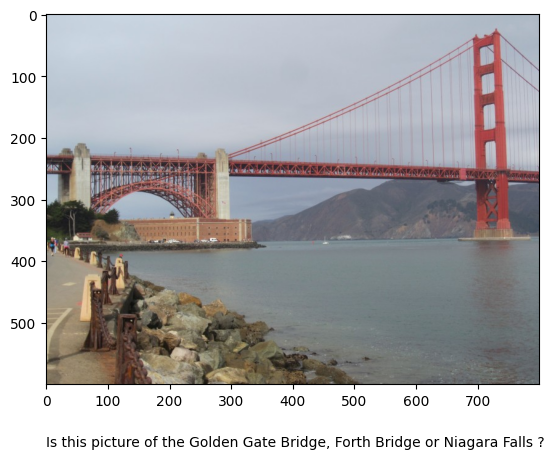

In [28]:
def suggest_locations(img_path):
    # get landmark predictions
    predicted_landmarks = predict_landmarks(img_path, 3)
    
    ## TODO: display image and display landmark predictions
    import matplotlib.pyplot as plt 
    img = plt.imread(Path(img_path))
    plt.imshow(img)
    plt.text(0,img.shape[0] + 100,f'Is this picture of the {", ".join(list(map(lambda x: x.replace("_"," "),predicted_landmarks[:-1])))} or {predicted_landmarks[-1].replace("_"," ")} ?')
    plt.show()
    
    

# test on a sample image
suggest_locations('images/test/09.Golden_Gate_Bridge/190f3bae17c32c37.jpg')

### (IMPLEMENTATION) Test Your Algorithm

Test your algorithm by running the `suggest_locations` function on at least four images on your computer. Feel free to use any images you like.

__Question 4:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ (Three possible points for improvement)
- Play with augmentations to improve the precision 
- Unfreeze some of the end layers in EffiecientNet to retrain and improve precision of the neural net
- Implemenet quantization aware training, and prune the network for improved performance.

landmark_images\test\00.Haleakala_National_Park\042517e40d998160.jpg
50


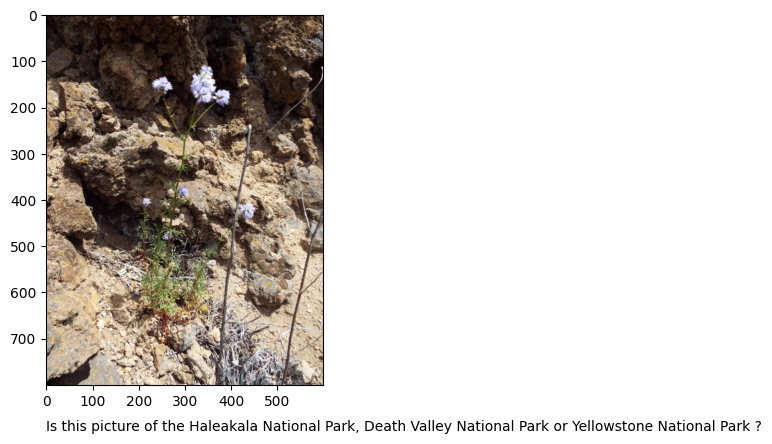

landmark_images\test\00.Haleakala_National_Park\329b1be89952a6ea.jpg
50


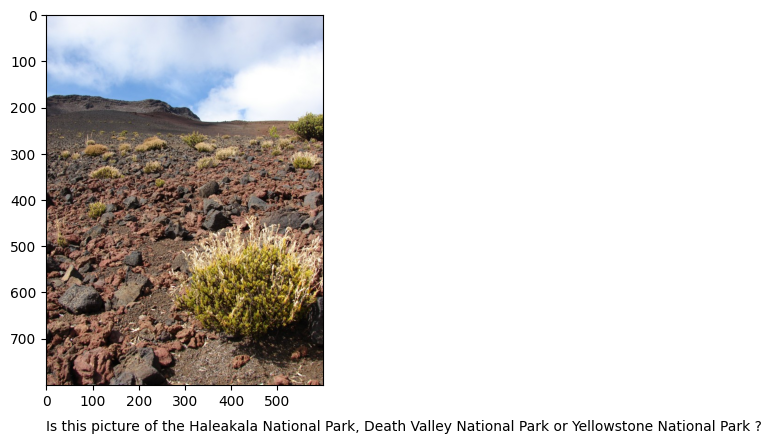

landmark_images\test\00.Haleakala_National_Park\79b4dc3771b2d75e.jpg
50


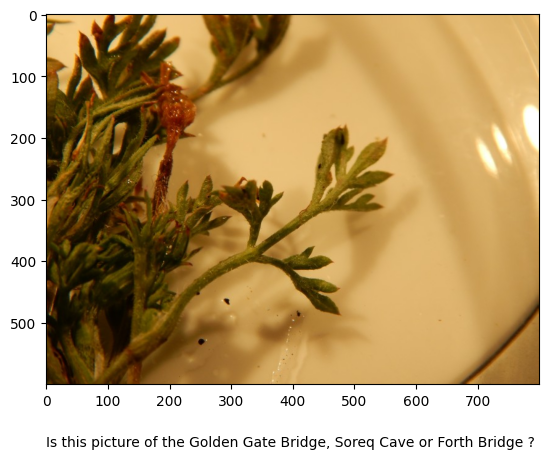

landmark_images\test\01.Mount_Rainier_National_Park\359e5588b6045ee8.jpg
50


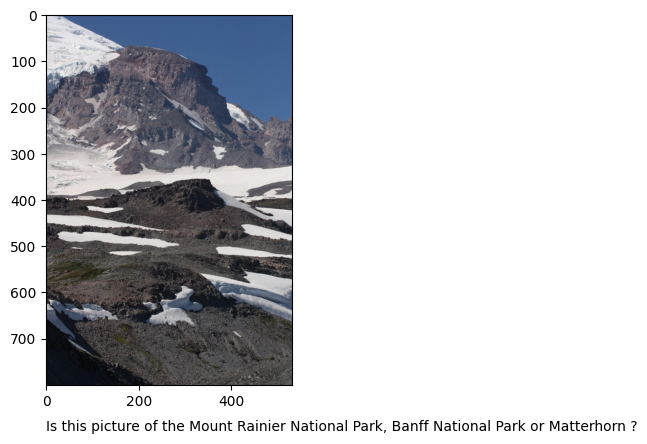

landmark_images\test\01.Mount_Rainier_National_Park\761daa5eded76313.jpg
50


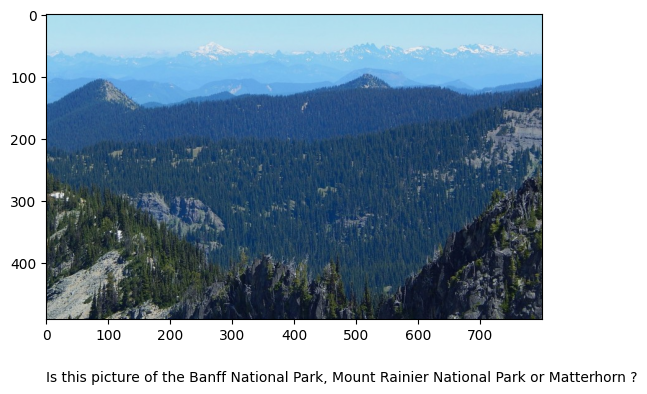

landmark_images\test\02.Ljubljana_Castle\1bafa4266447ca3c.jpg
50


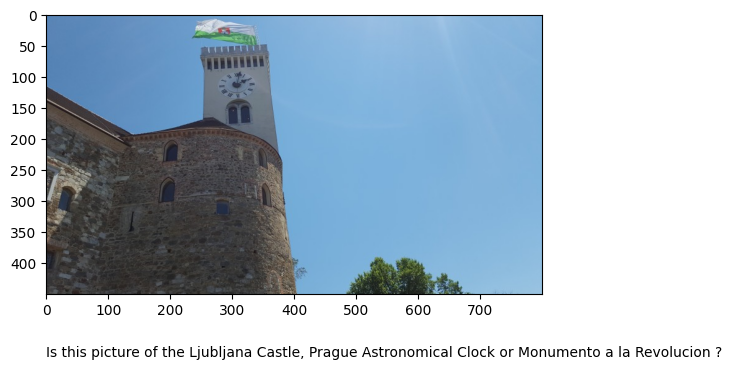

landmark_images\test\02.Ljubljana_Castle\6eafeab9c5b50e93.jpg
50


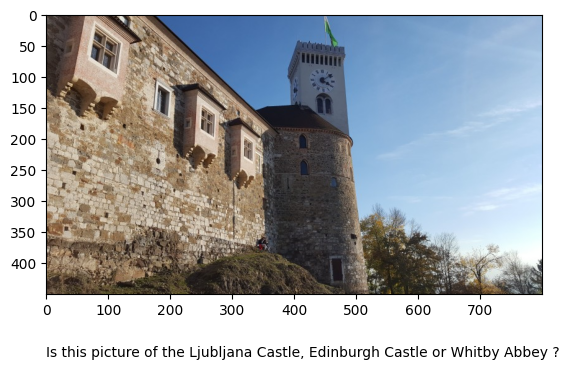

landmark_images\test\03.Dead_Sea\0b5870c7c410cd37.jpg
50


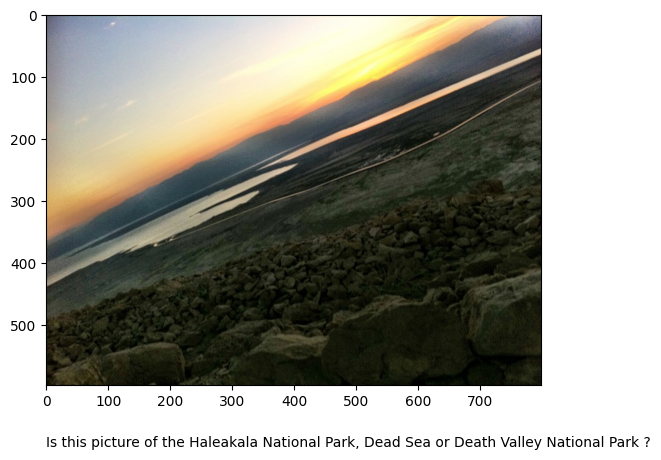

landmark_images\test\03.Dead_Sea\3e61918614c39f96.jpg
50


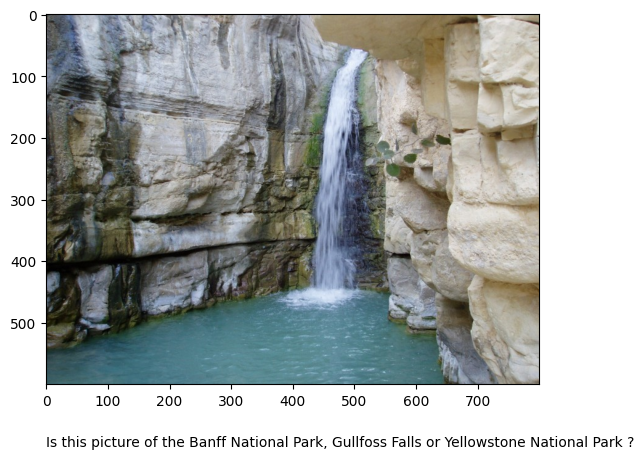

landmark_images\test\03.Dead_Sea\7e0f9f4f14eb9af1.jpg
50


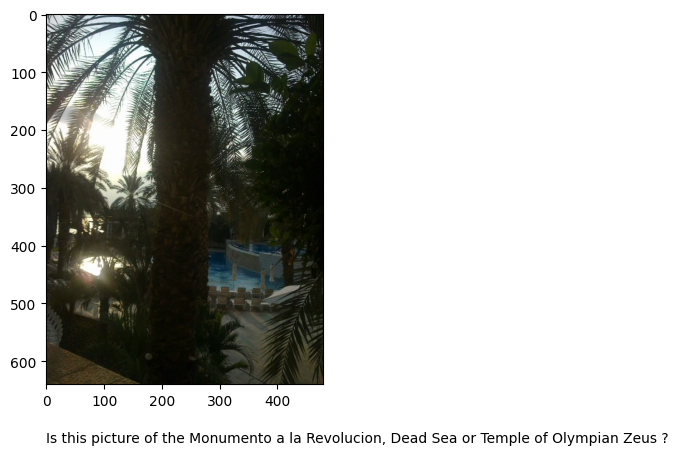

landmark_images\test\04.Wroclaws_Dwarves\428e988c4b8d9d3e.jpg
50


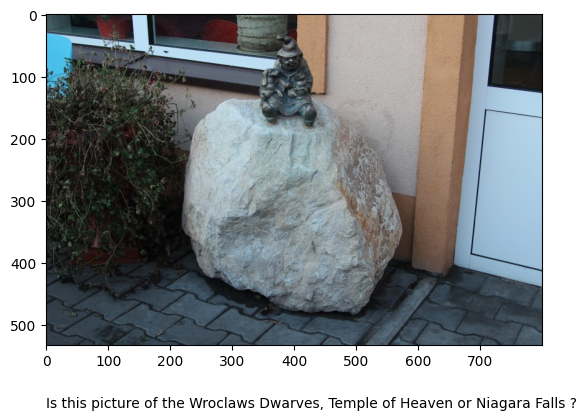

landmark_images\test\04.Wroclaws_Dwarves\76f6e138ec02d56c.jpg
50


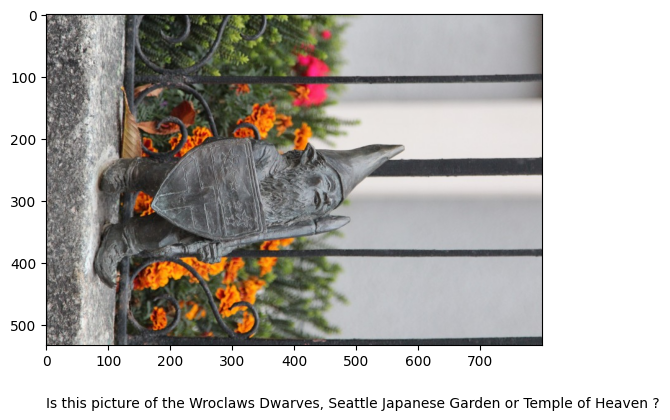

landmark_images\test\05.London_Olympic_Stadium\2b924dbe0974d3ea.jpg
50


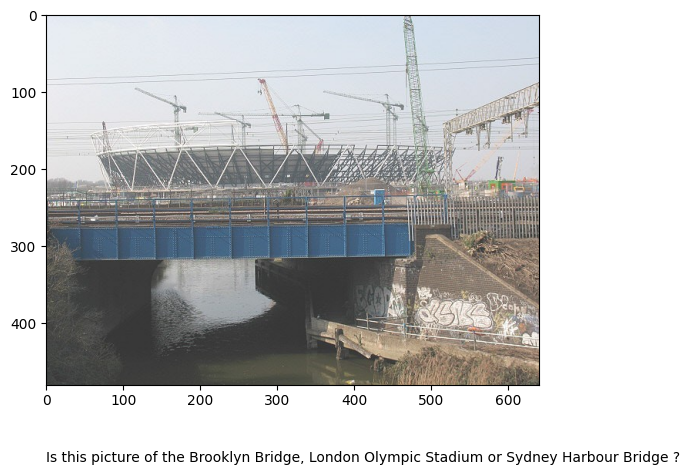

landmark_images\test\05.London_Olympic_Stadium\63a2a1d2880a8b9c.jpg
50


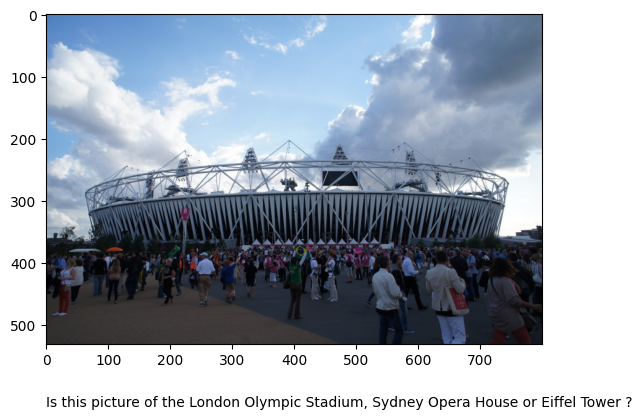

landmark_images\test\06.Niagara_Falls\0c2aef04fe14c796.jpg
50


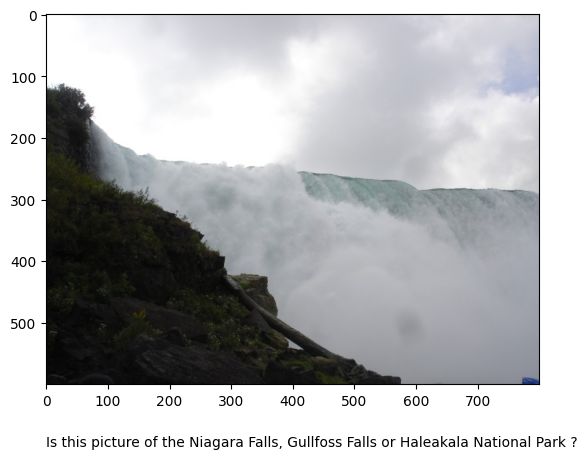

landmark_images\test\06.Niagara_Falls\428a5466eb258107.jpg
50


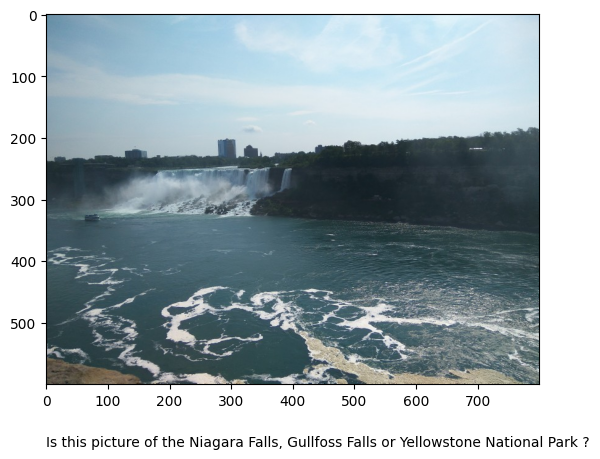

landmark_images\test\07.Stonehenge\04d1a195c7e6c899.jpg
50


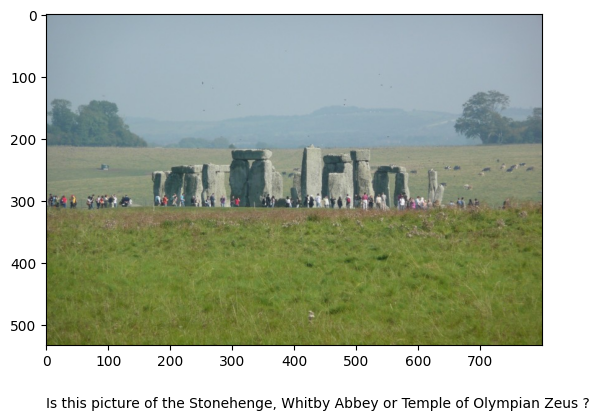

landmark_images\test\07.Stonehenge\4169404dc415eb89.jpg
50


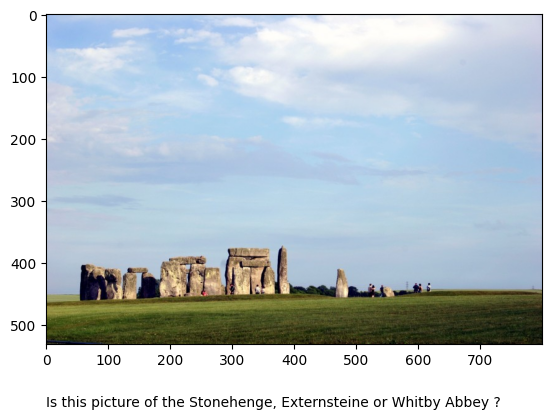

landmark_images\test\07.Stonehenge\7b38a3fa5b58466c.jpg
50


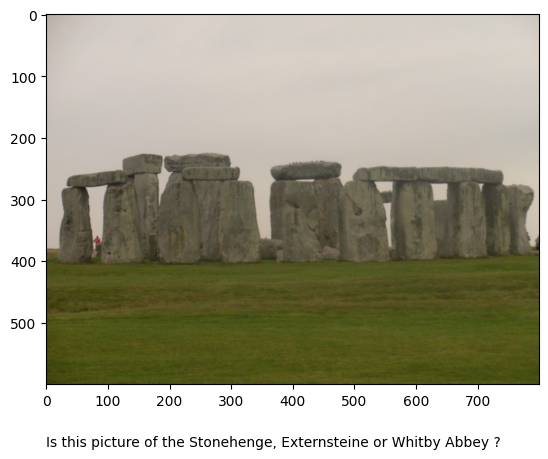

landmark_images\test\08.Grand_Canyon\2f64a93067e8eb13.jpg
50


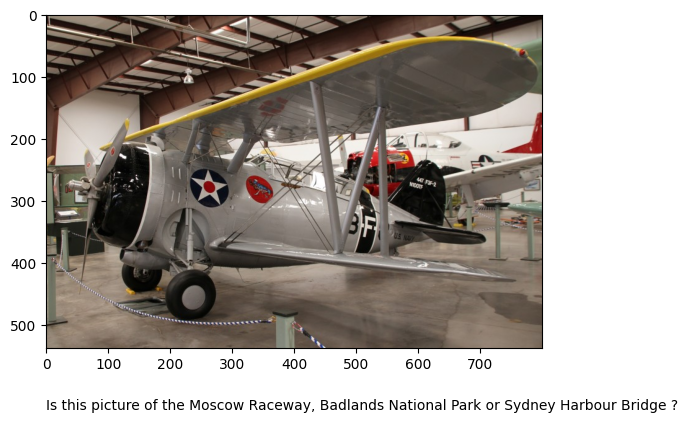

landmark_images\test\08.Grand_Canyon\6b659b399ccd04ad.jpg
50


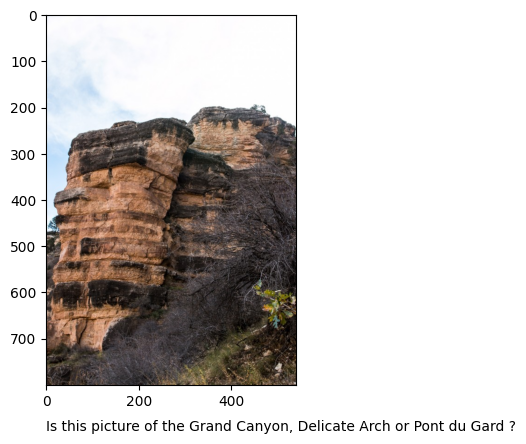

landmark_images\test\09.Golden_Gate_Bridge\1bc7a7f05288153b.jpg
50


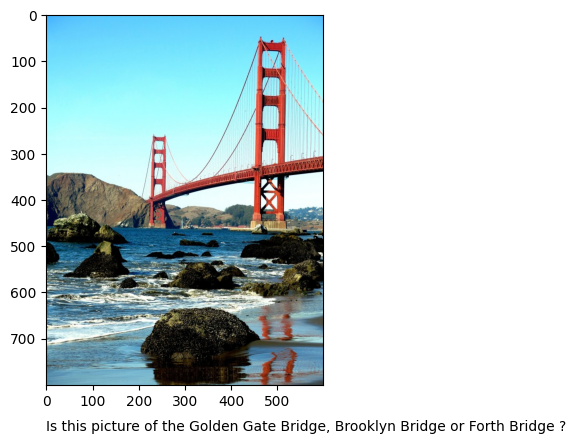

landmark_images\test\09.Golden_Gate_Bridge\5ed314bab8075930.jpg
50


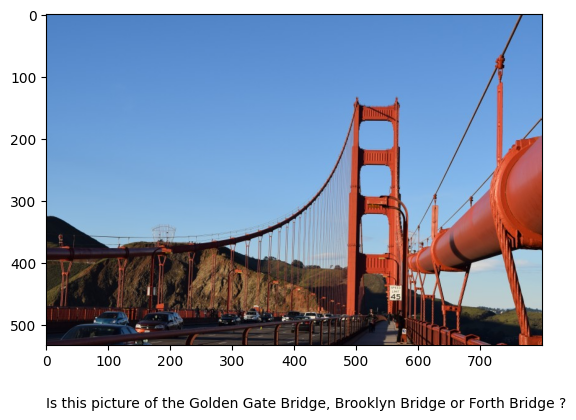

landmark_images\test\10.Edinburgh_Castle\19eab04e683dfe4a.jpg
50


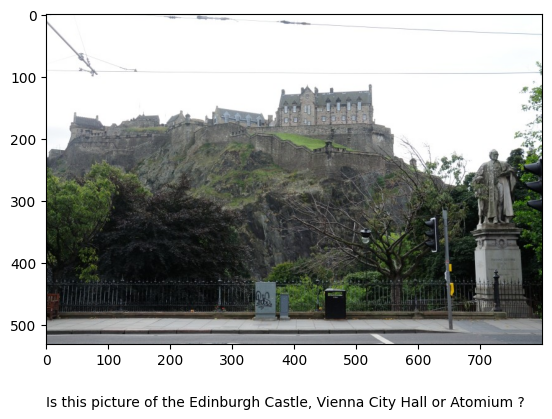

landmark_images\test\10.Edinburgh_Castle\56fe194601f8ae9c.jpg
50


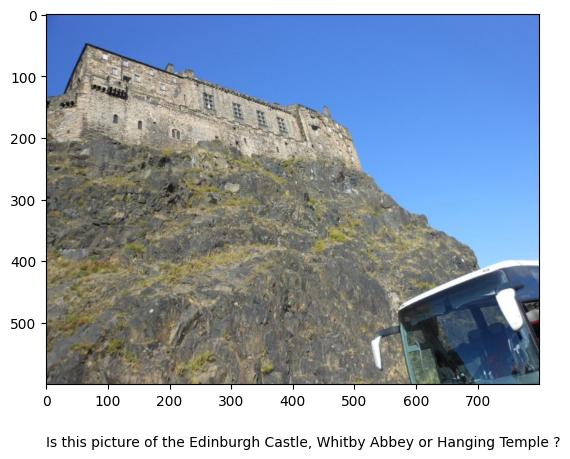

landmark_images\test\11.Mount_Rushmore_National_Memorial\0855bcdafebf7158.jpg
50


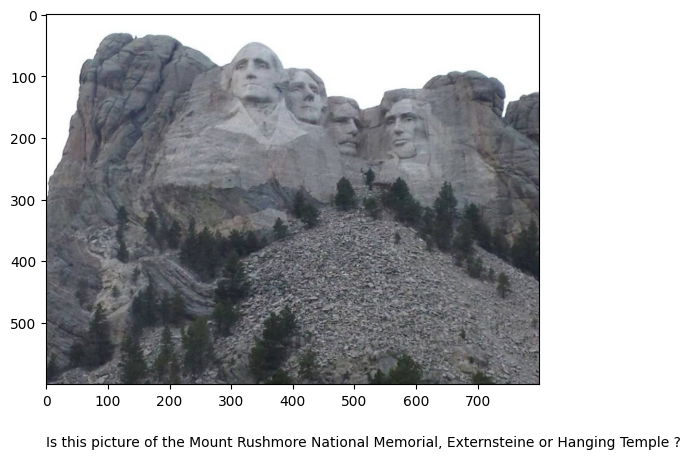

landmark_images\test\11.Mount_Rushmore_National_Memorial\3e533c14e48e0de3.jpg
50


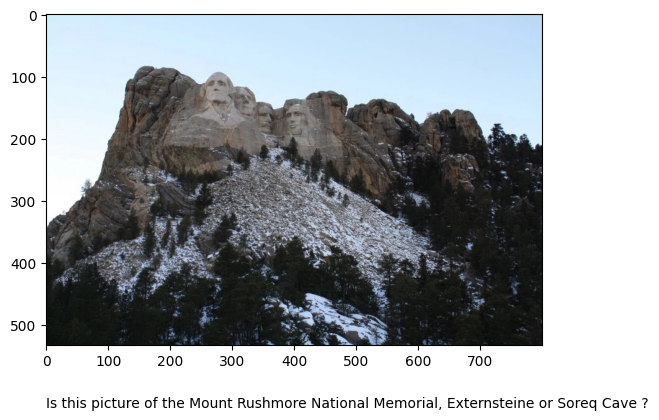

landmark_images\test\11.Mount_Rushmore_National_Memorial\78f9654319180e1b.jpg
50


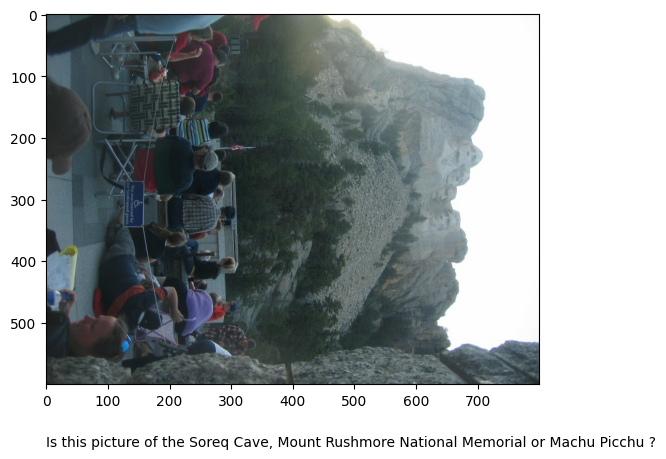

landmark_images\test\12.Kantanagar_Temple\2c8606adee9504a5.jpg
50


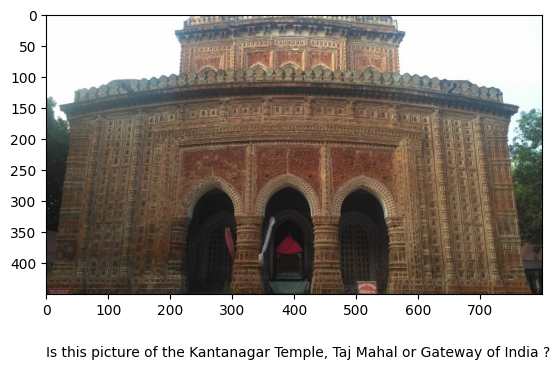

landmark_images\test\12.Kantanagar_Temple\61be51b7ec39e372.jpg
50


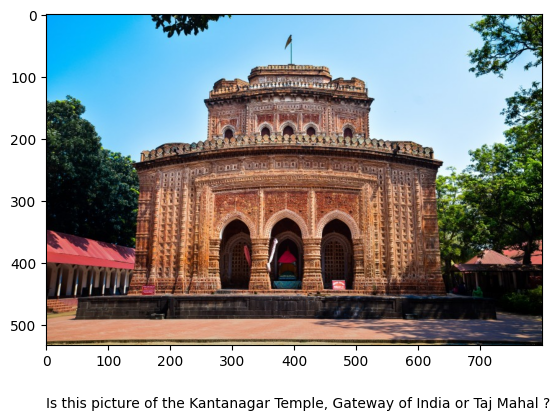

landmark_images\test\13.Yellowstone_National_Park\305775082f1b7f02.jpg
50


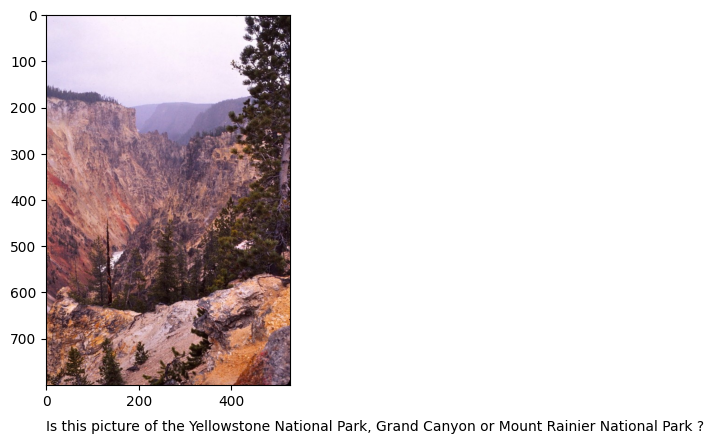

landmark_images\test\13.Yellowstone_National_Park\51a0bb6d380b6fef.jpg
50


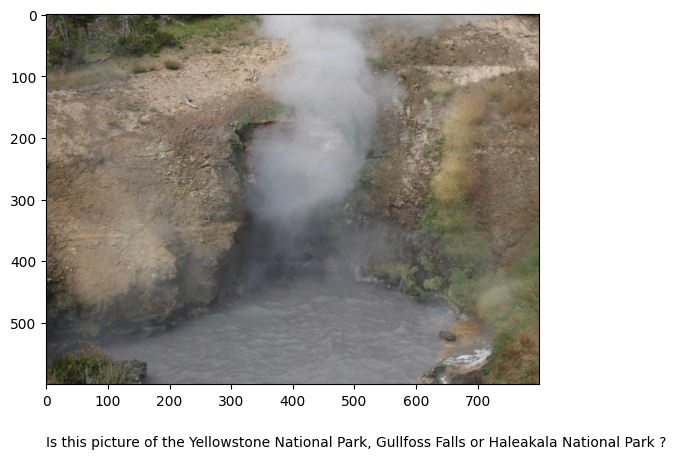

landmark_images\test\14.Terminal_Tower\1a42461138f606c9.jpg
50


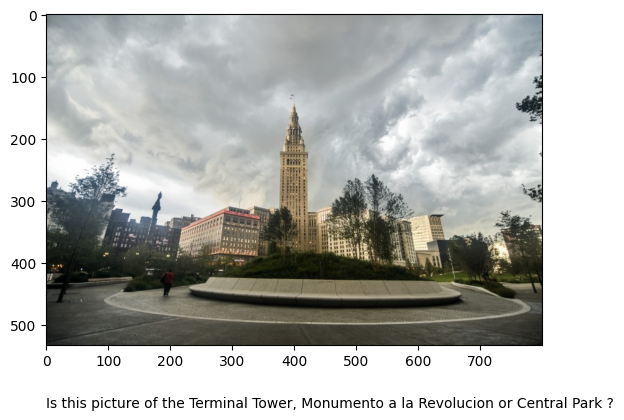

landmark_images\test\14.Terminal_Tower\3eee8eab1d93207a.jpg
50


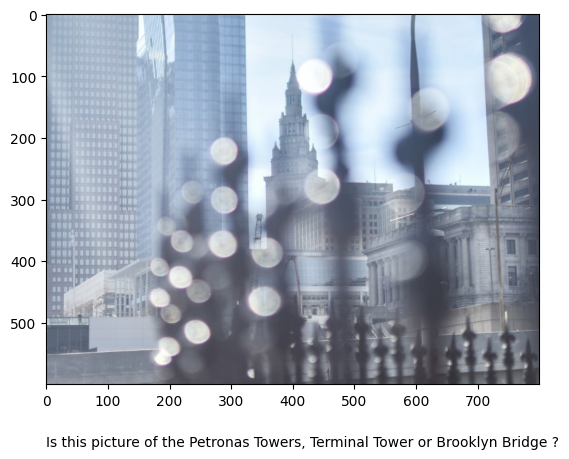

landmark_images\test\14.Terminal_Tower\7dffcaf9f66d3fc2.jpg
50


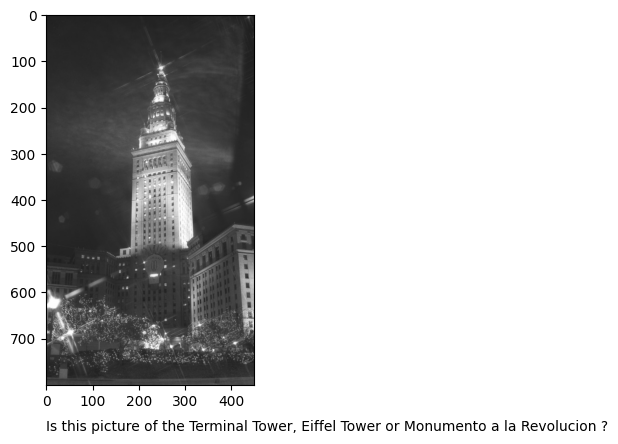

landmark_images\test\15.Central_Park\3b005ec4bf8e5b85.jpg
50


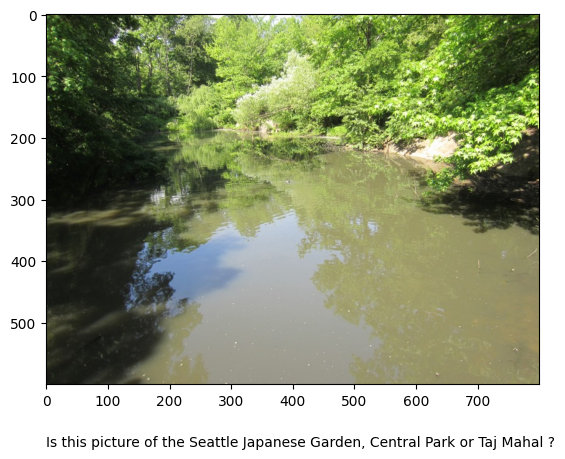

landmark_images\test\15.Central_Park\6efa9ed216cfaca5.jpg
50


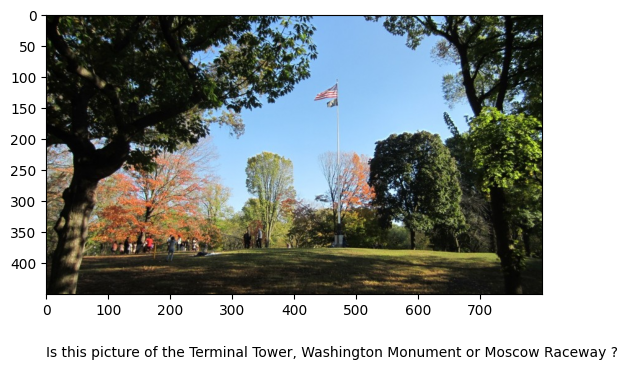

landmark_images\test\16.Eiffel_Tower\26f82dab964ef649.jpg
50


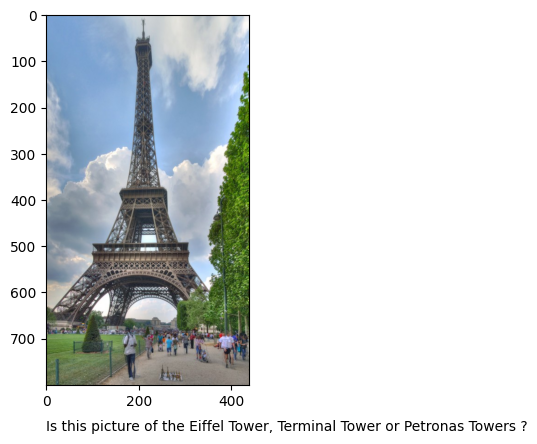

landmark_images\test\16.Eiffel_Tower\58d099b15ee74b73.jpg
50


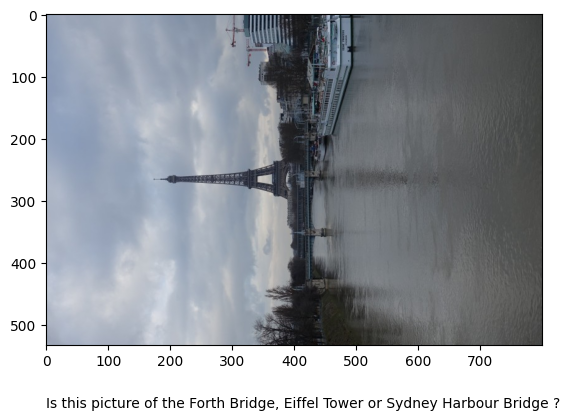

landmark_images\test\17.Changdeokgung\0b95751e4ccbbd19.jpg
50


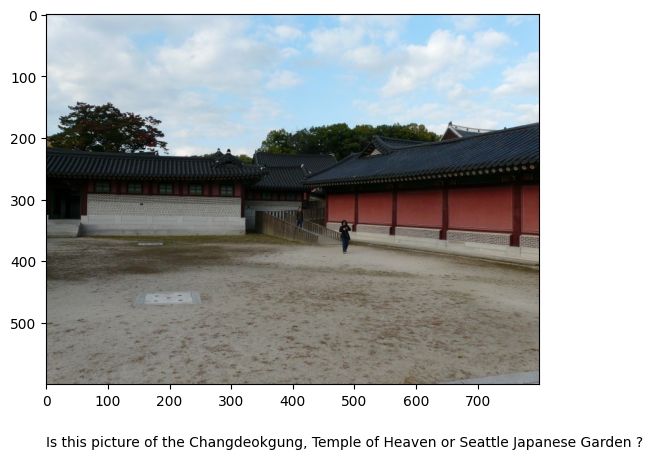

landmark_images\test\17.Changdeokgung\5856e204147c49fa.jpg
50


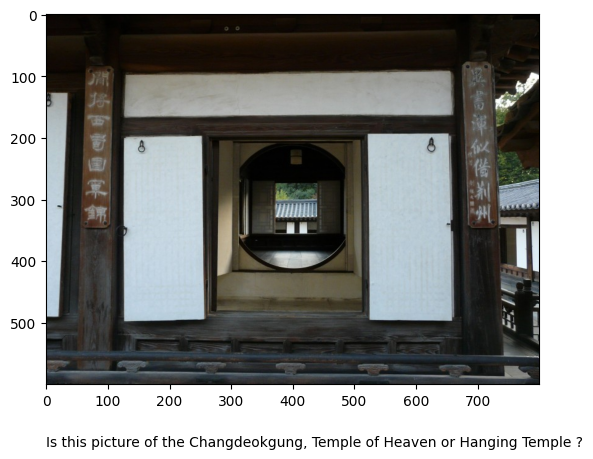

landmark_images\test\18.Delicate_Arch\0a644b21cc4f7eb5.jpg
50


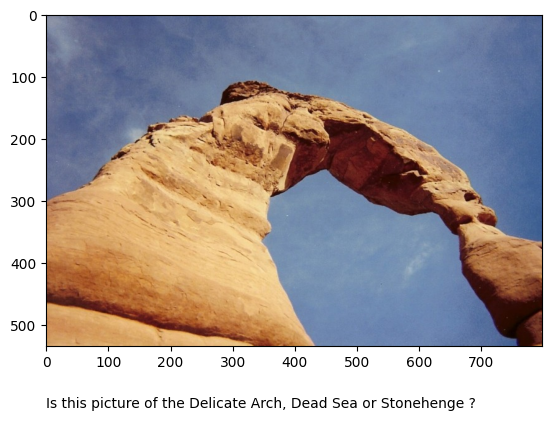

landmark_images\test\18.Delicate_Arch\2c630f04fcd24719.jpg
50


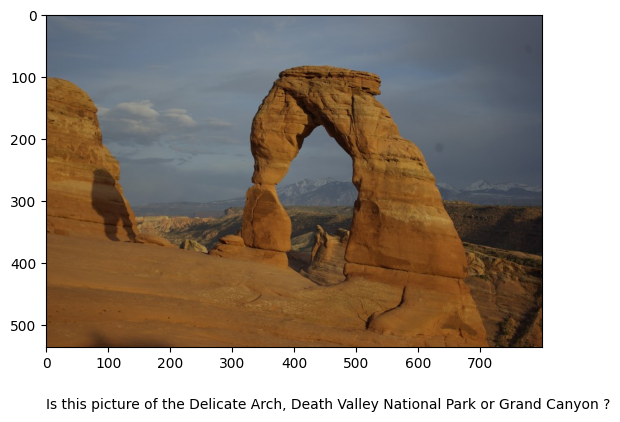

landmark_images\test\18.Delicate_Arch\774e3f8f7a9c3604.jpg
50


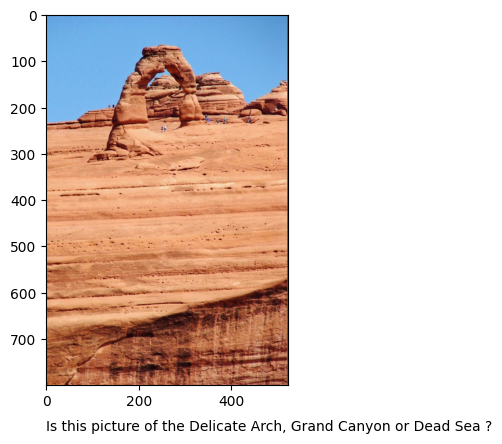

landmark_images\test\19.Vienna_City_Hall\33fdae363340e364.jpg
50


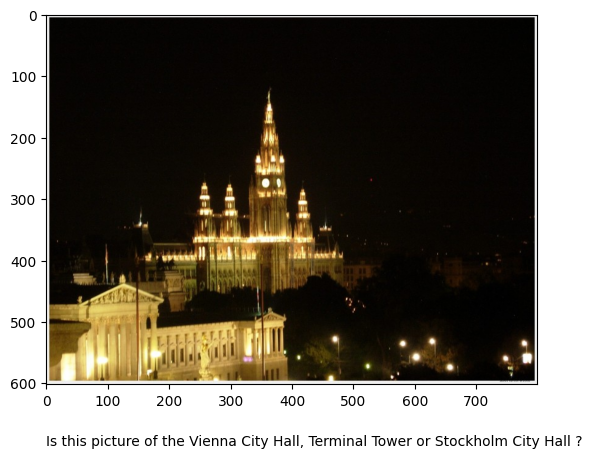

landmark_images\test\19.Vienna_City_Hall\56718759419f44c9.jpg
50


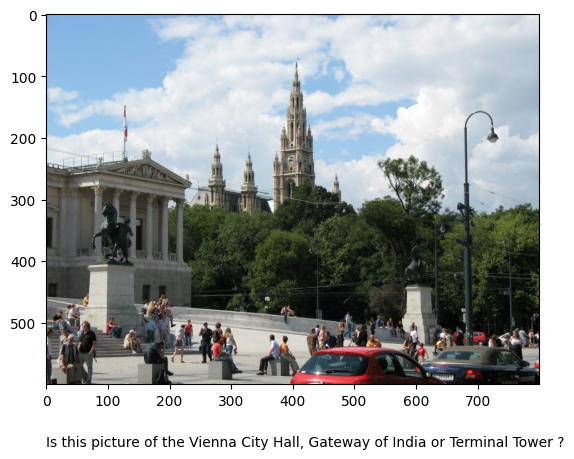

landmark_images\test\20.Matterhorn\1876d4590a15fc46.jpg
50


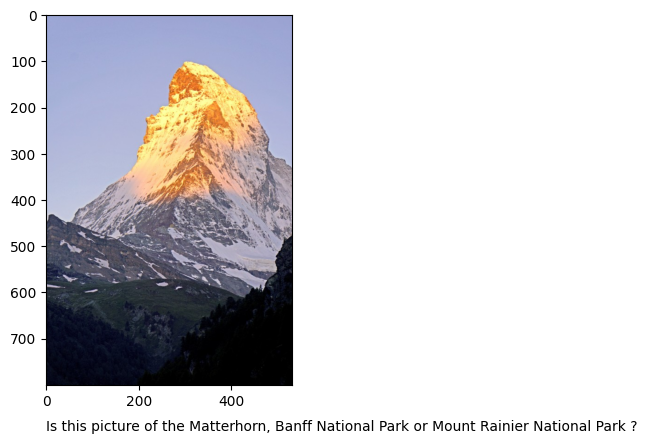

landmark_images\test\20.Matterhorn\4fba1da3235d07d6.jpg
50


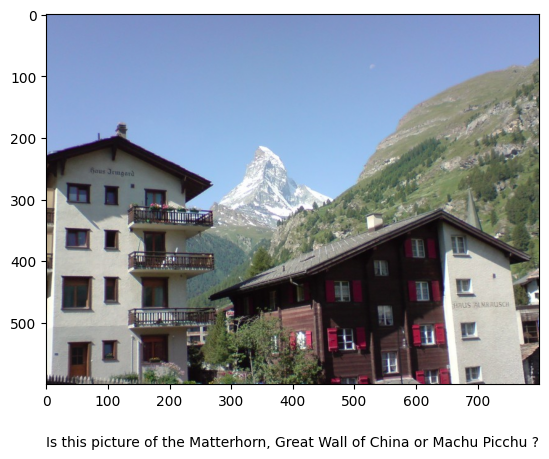

landmark_images\test\21.Taj_Mahal\14a11ddef5fb84af.jpg
50


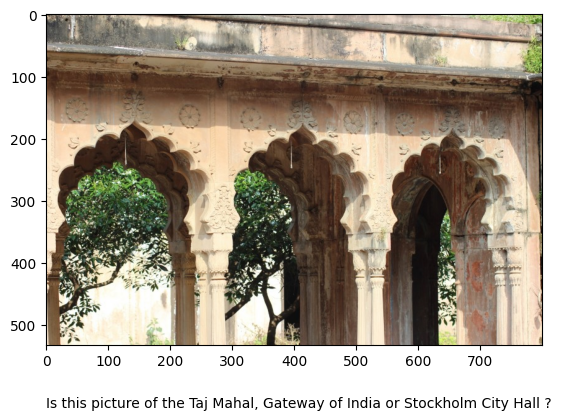

landmark_images\test\21.Taj_Mahal\5469792e0b15c65f.jpg
50


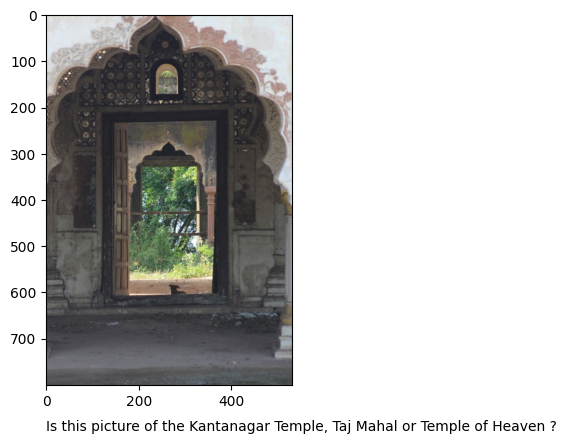

landmark_images\test\22.Moscow_Raceway\01969b4e5e396b31.jpg
50


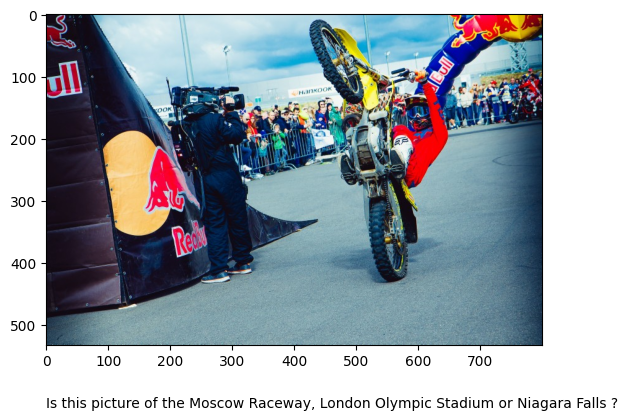

landmark_images\test\22.Moscow_Raceway\44f1ca5a50e7ce91.jpg
50


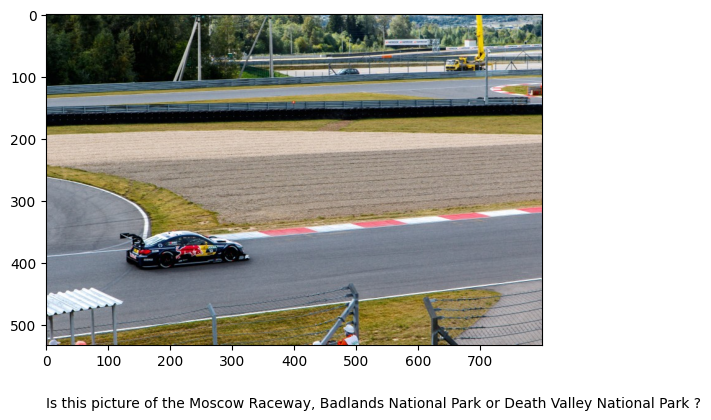

landmark_images\test\22.Moscow_Raceway\6a87c4ef304dc4b3.jpg
50


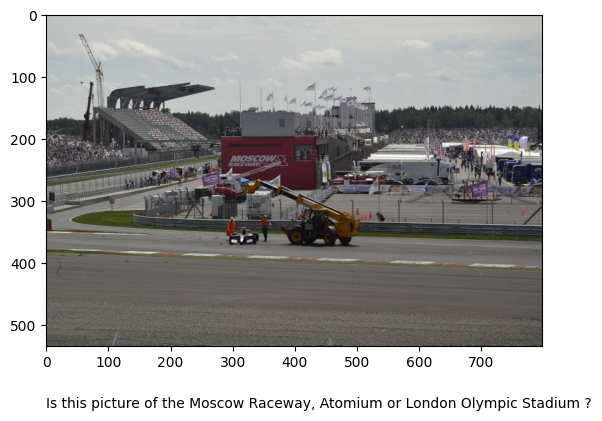

landmark_images\test\23.Externsteine\2ddb9fd370c9eb08.jpg
50


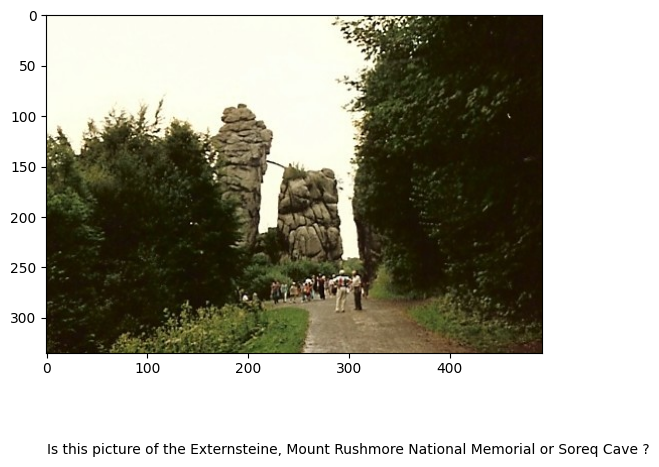

landmark_images\test\23.Externsteine\664f1b750e82782f.jpg
50


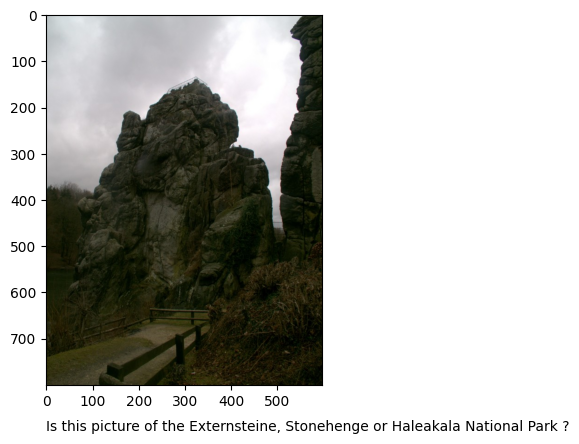

landmark_images\test\24.Soreq_Cave\2f6b1b995778b892.jpg
50


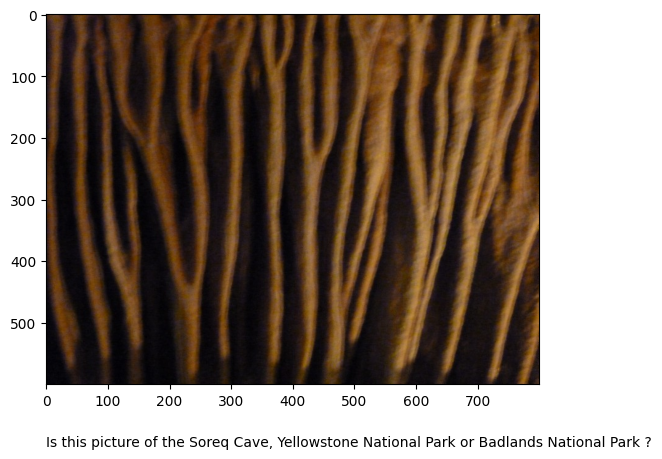

landmark_images\test\24.Soreq_Cave\581cfaa4280a860d.jpg
50


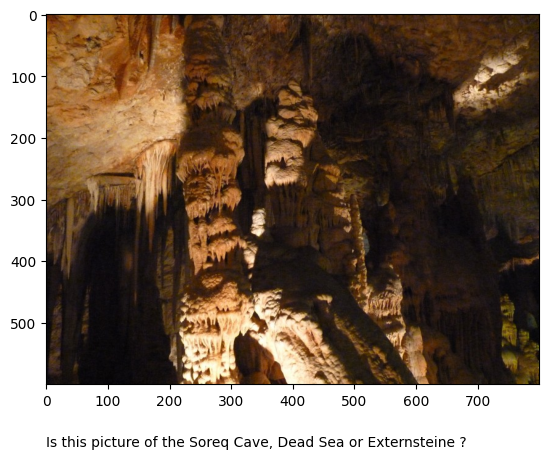

landmark_images\test\25.Banff_National_Park\182da82f82e6a787.jpg
50


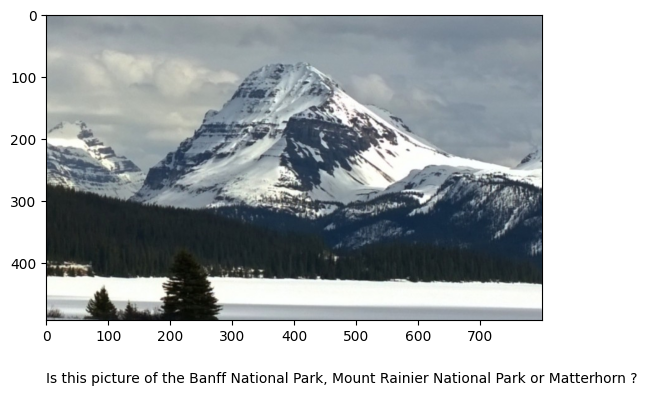

landmark_images\test\25.Banff_National_Park\4095e61a71b4e958.jpg
50


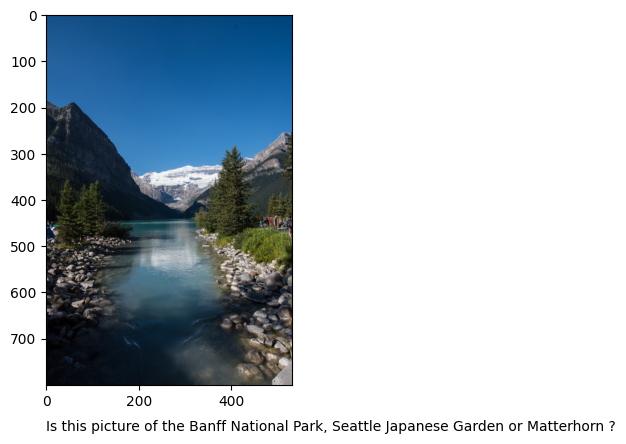

landmark_images\test\25.Banff_National_Park\7f1242fc19c69e0a.jpg
50


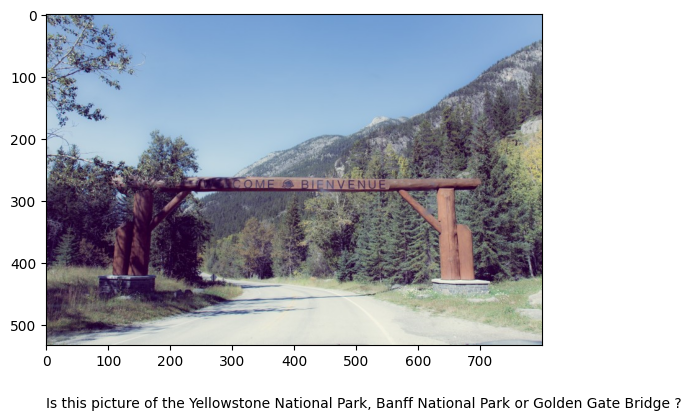

landmark_images\test\26.Pont_du_Gard\460f9442170554e6.jpg
50


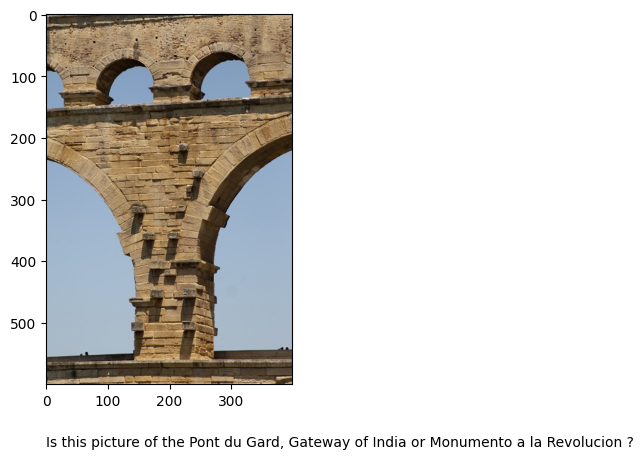

landmark_images\test\26.Pont_du_Gard\6d33150d95313039.jpg
50


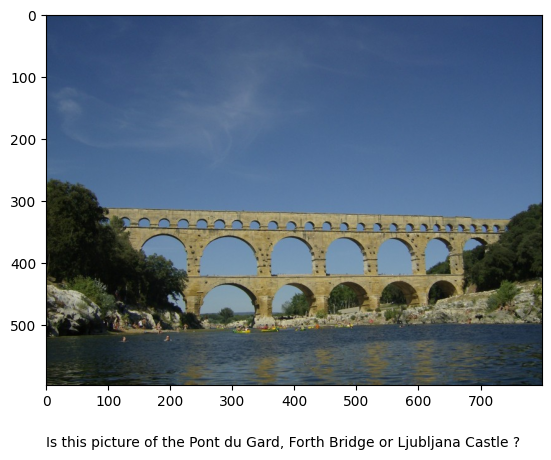

landmark_images\test\27.Seattle_Japanese_Garden\24621d0983313599.jpg
50


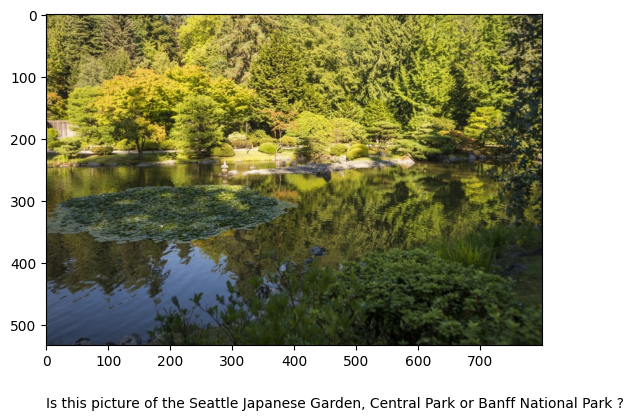

landmark_images\test\27.Seattle_Japanese_Garden\682139f4cc6412be.jpg
50


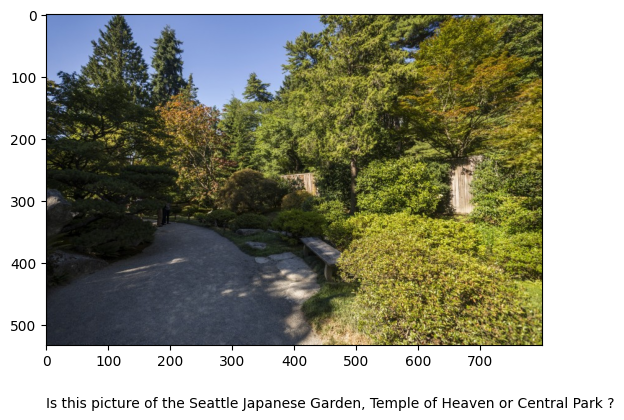

landmark_images\test\28.Sydney_Harbour_Bridge\16c0f11519d5a2b5.jpg
50


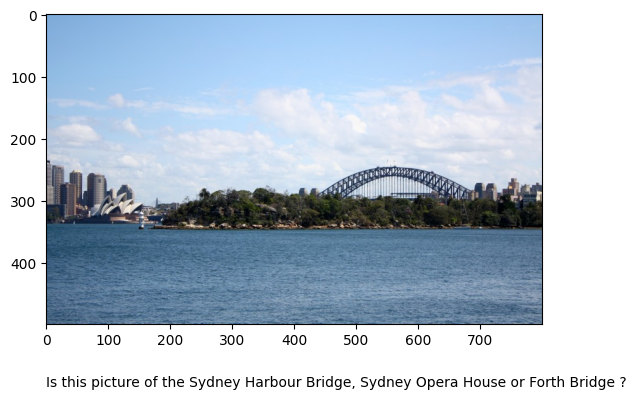

landmark_images\test\28.Sydney_Harbour_Bridge\4e25a44e02916049.jpg
50


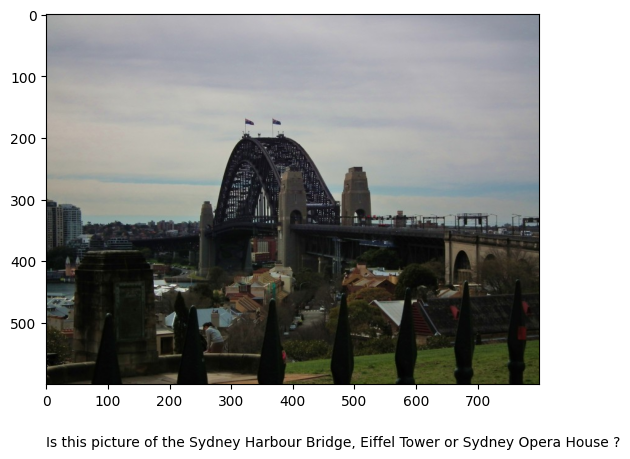

landmark_images\test\29.Petronas_Towers\0ae950a45582e3a1.jpg
50


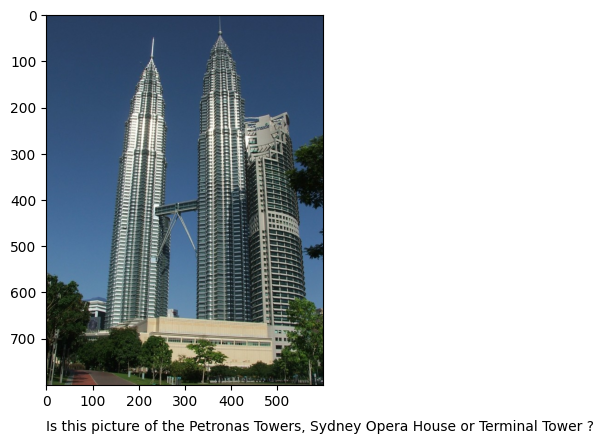

landmark_images\test\29.Petronas_Towers\3dfb07dbf222ed0a.jpg
50


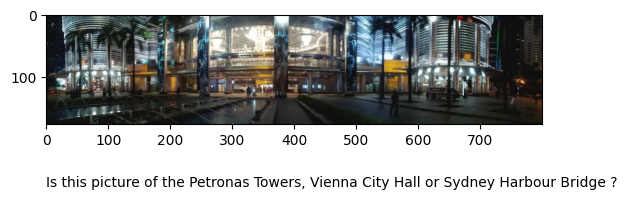

landmark_images\test\29.Petronas_Towers\7a60edac1920a106.jpg
50


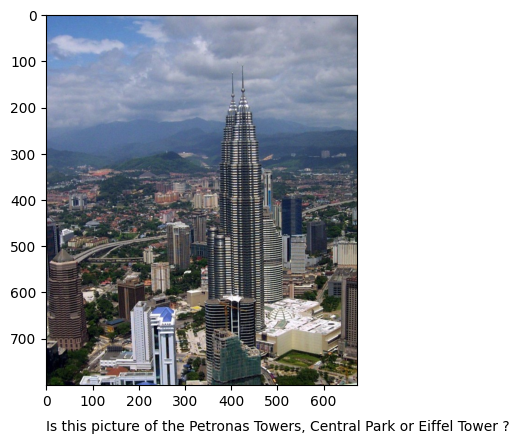

landmark_images\test\30.Brooklyn_Bridge\2b2061fbe0abcb7c.jpg
50


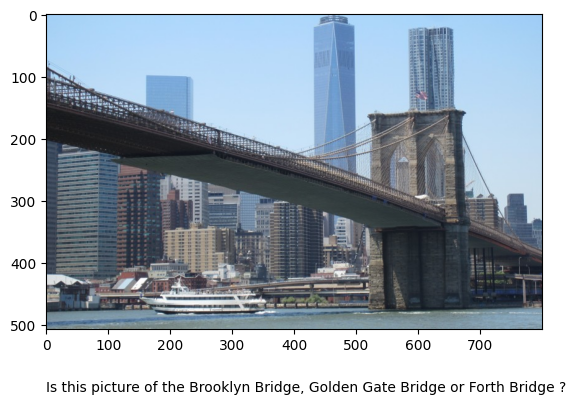

landmark_images\test\30.Brooklyn_Bridge\76b3106b046d3f45.jpg
50


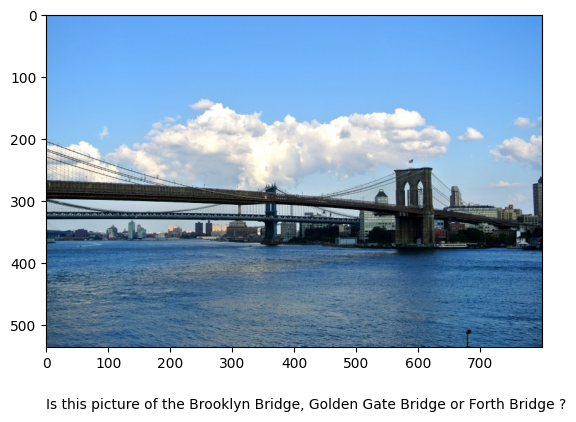

landmark_images\test\31.Washington_Monument\1d18a23956807778.jpg
50


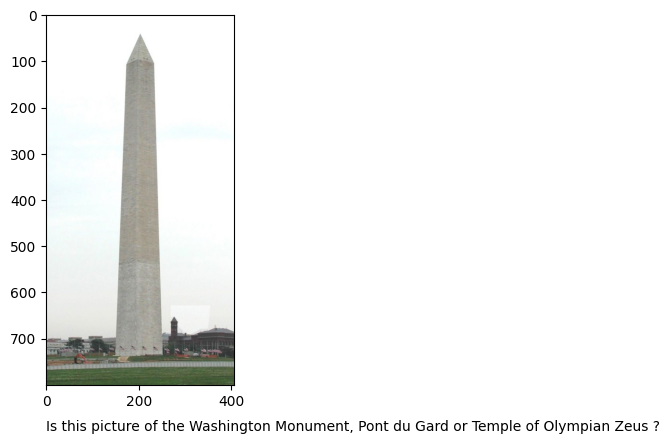

landmark_images\test\31.Washington_Monument\3f92ba97b309ced8.jpg
50


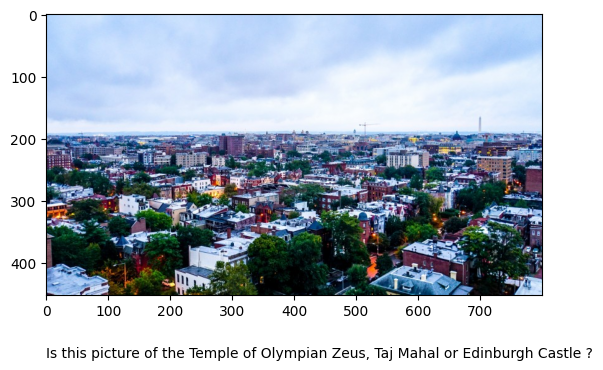

landmark_images\test\32.Hanging_Temple\1ce97b98d1313aaf.jpg
50


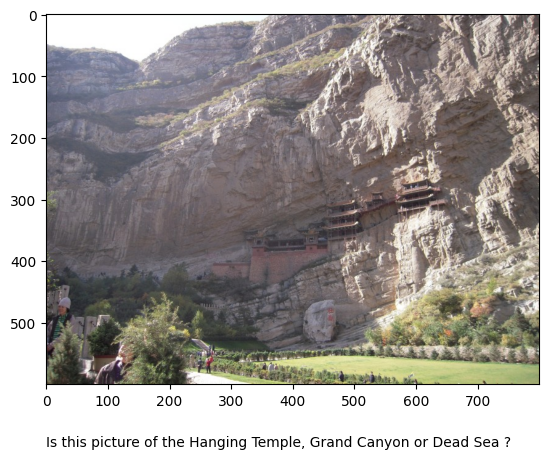

landmark_images\test\32.Hanging_Temple\6b4607c002f7f621.jpg
50


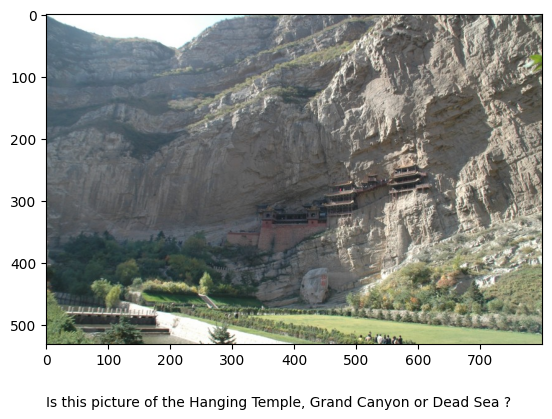

landmark_images\test\33.Sydney_Opera_House\08087d98660bdbd8.jpg
50


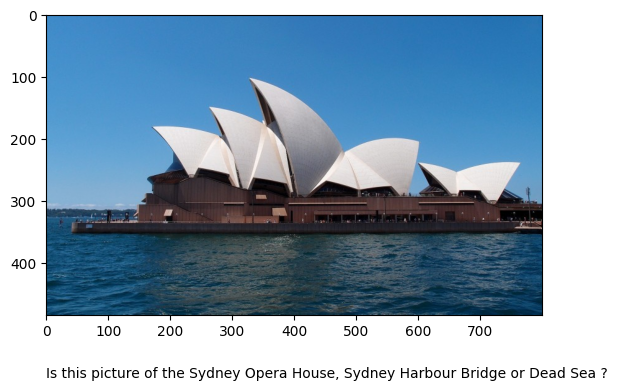

landmark_images\test\33.Sydney_Opera_House\2c89aedd9e0ee12a.jpg
50


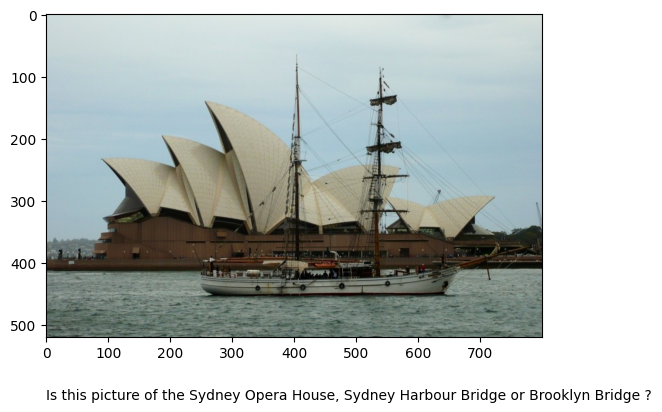

landmark_images\test\33.Sydney_Opera_House\72be97459cedc17c.jpg
50


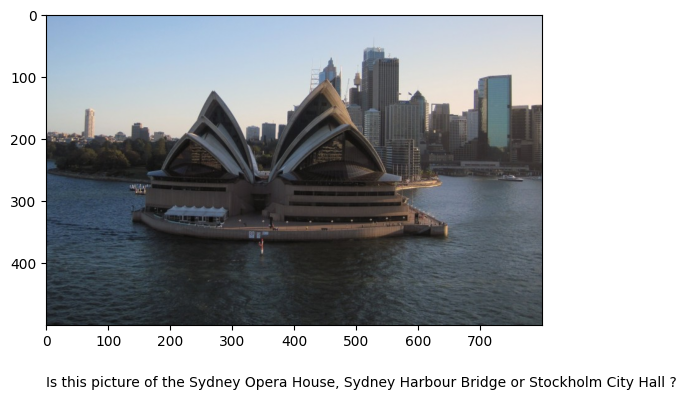

landmark_images\test\34.Great_Barrier_Reef\4a0ea6d00fffc5de.jpg
50


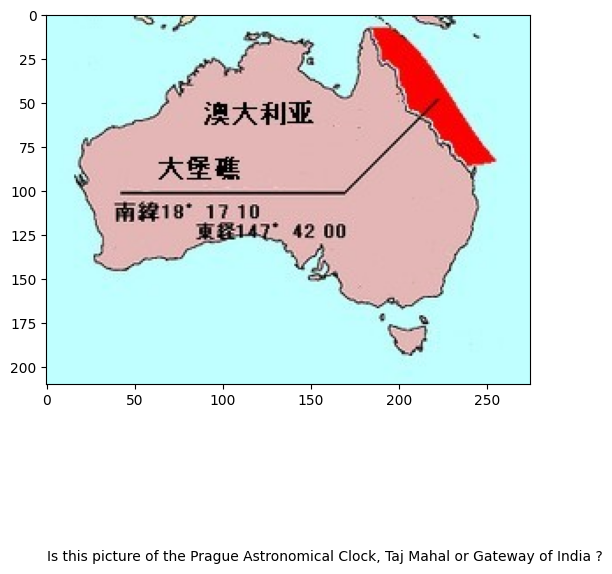

landmark_images\test\34.Great_Barrier_Reef\685ce33c2c8b0178.jpg
50


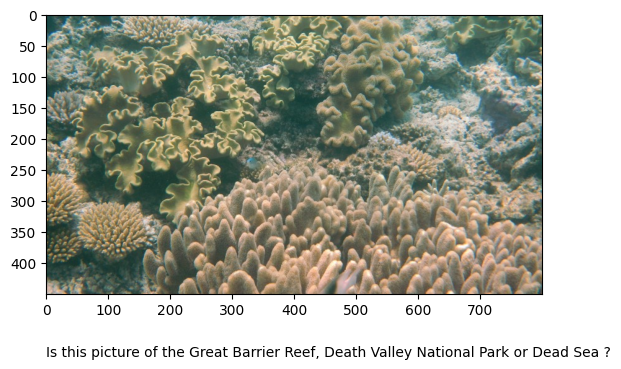

landmark_images\test\35.Monumento_a_la_Revolucion\1c793b20cdbb8b11.jpg
50


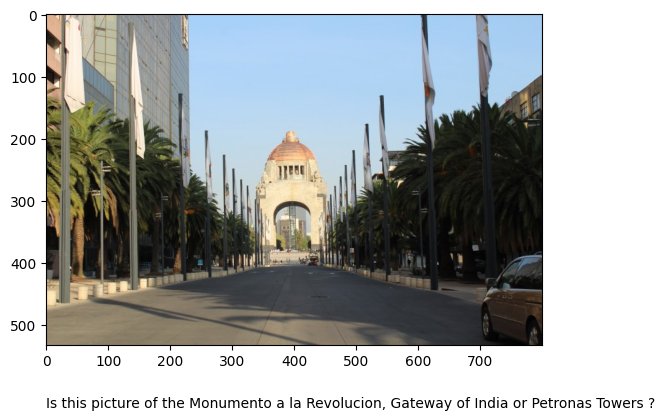

landmark_images\test\35.Monumento_a_la_Revolucion\57ae5d0f31394c5a.jpg
50


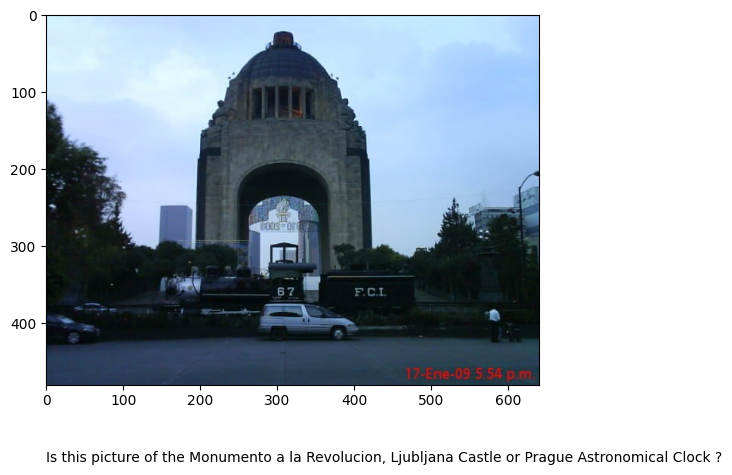

landmark_images\test\36.Badlands_National_Park\0e3c975ccbf0442a.jpg
50


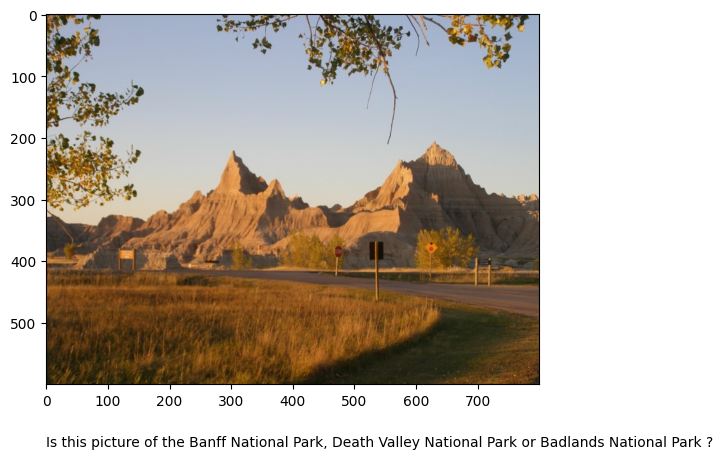

landmark_images\test\36.Badlands_National_Park\4dde9187cb31166e.jpg
50


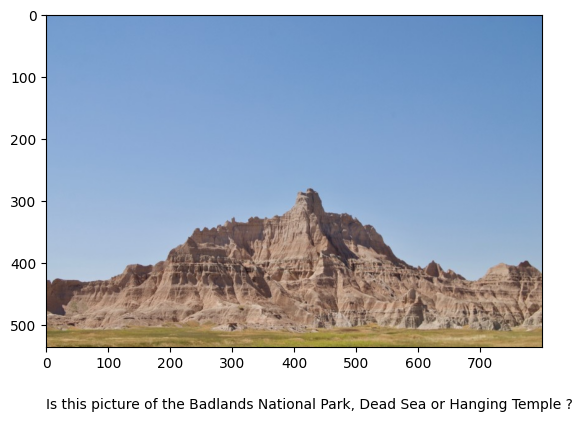

landmark_images\test\36.Badlands_National_Park\7bd45178170d75c6.jpg
50


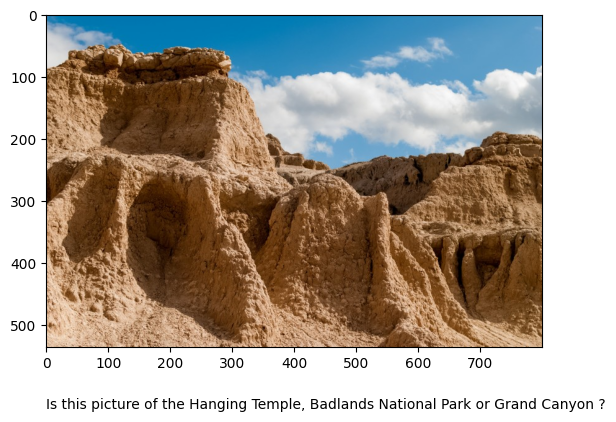

landmark_images\test\37.Atomium\2ac5b8d85225d0f9.jpg
50


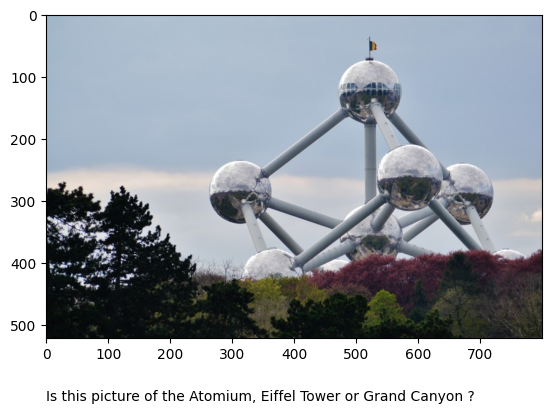

landmark_images\test\37.Atomium\7657e4e93df87dca.jpg
50


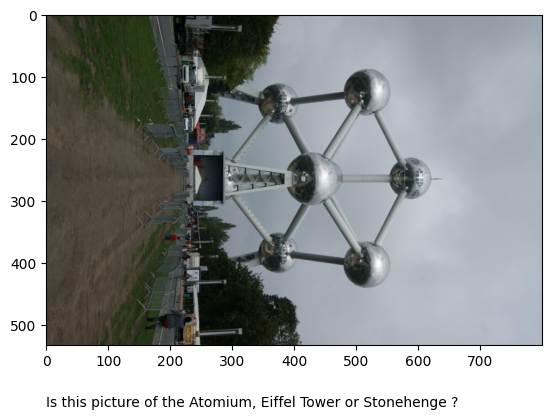

landmark_images\test\38.Forth_Bridge\3747ee03a240fa8b.jpg
50


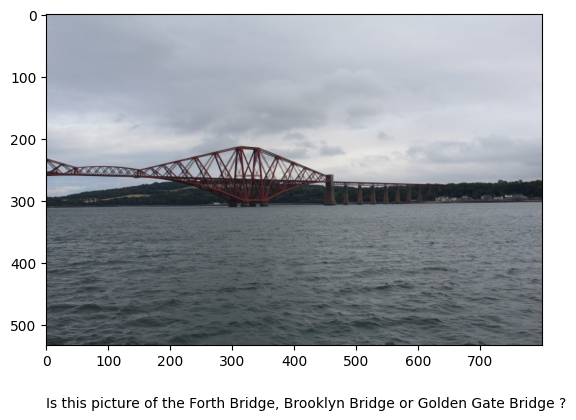

landmark_images\test\38.Forth_Bridge\6183bc69574d7045.jpg
50


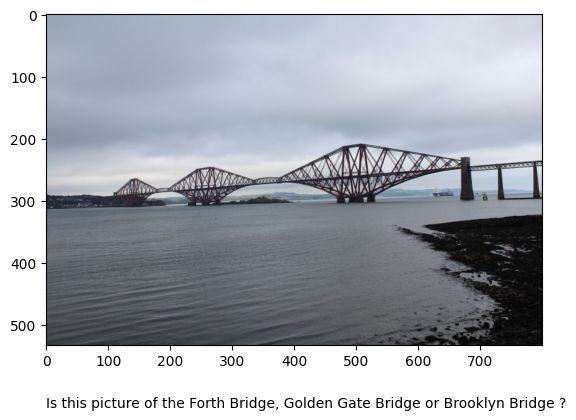

landmark_images\test\39.Gateway_of_India\1e7955ba85230d5c.jpg
50


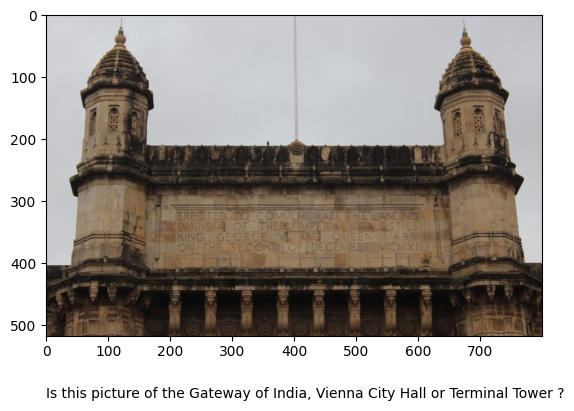

landmark_images\test\39.Gateway_of_India\58cc79f7c256fe4f.jpg
50


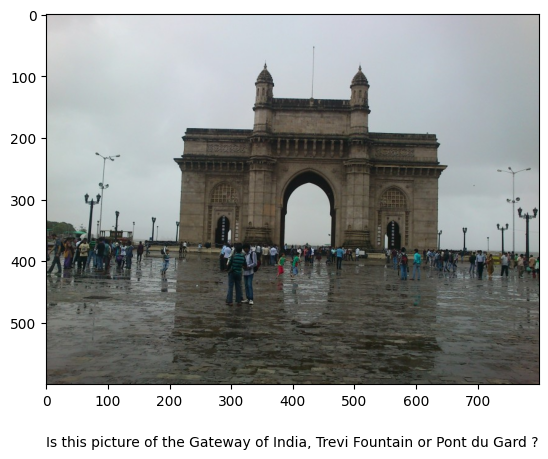

landmark_images\test\40.Stockholm_City_Hall\13b55db86563dac5.jpg
50


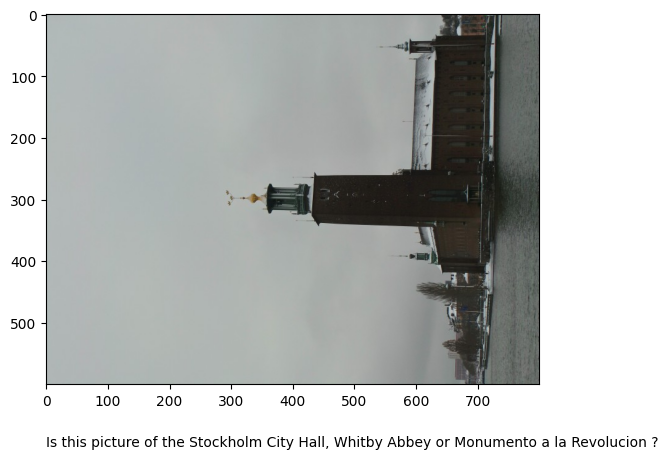

landmark_images\test\40.Stockholm_City_Hall\446cfcfa4d1d852d.jpg
50


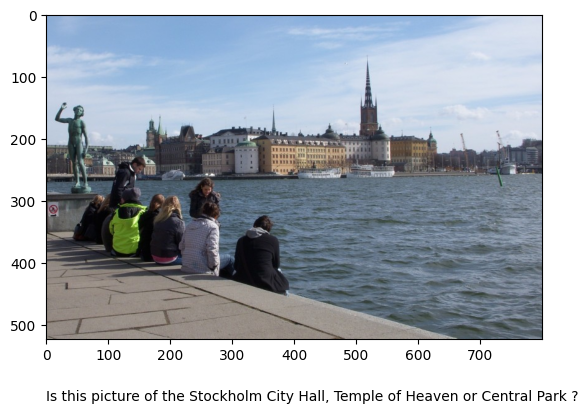

landmark_images\test\40.Stockholm_City_Hall\7ded0527ac0c860b.jpg
50


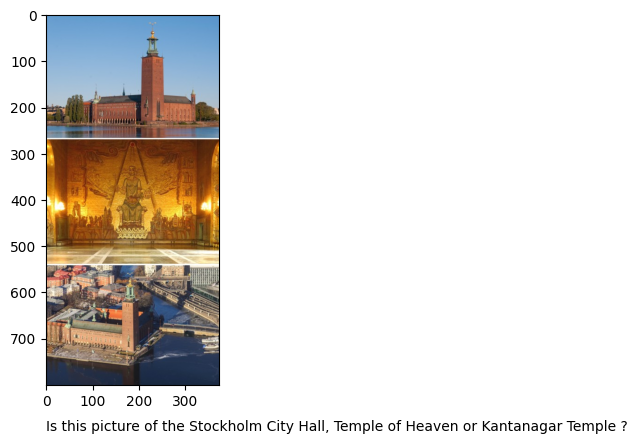

landmark_images\test\41.Machu_Picchu\2f0f11e947907961.jpg
50


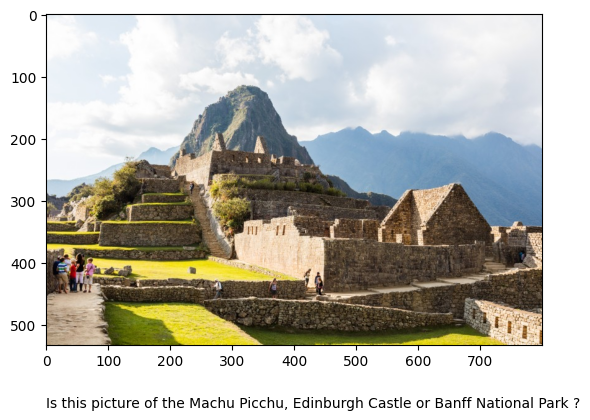

landmark_images\test\41.Machu_Picchu\529aeaecb9ba4257.jpg
50


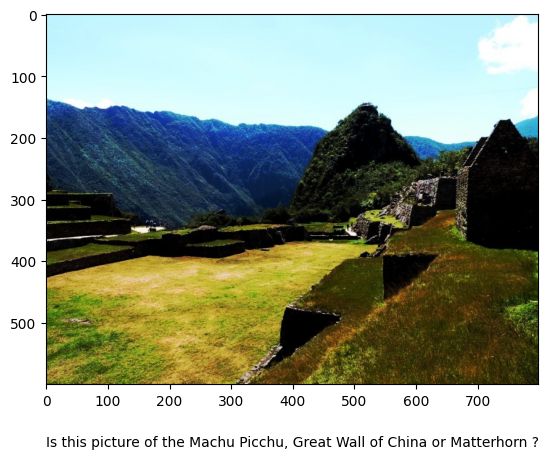

landmark_images\test\42.Death_Valley_National_Park\1a8bf9cb96818d8d.jpg
50


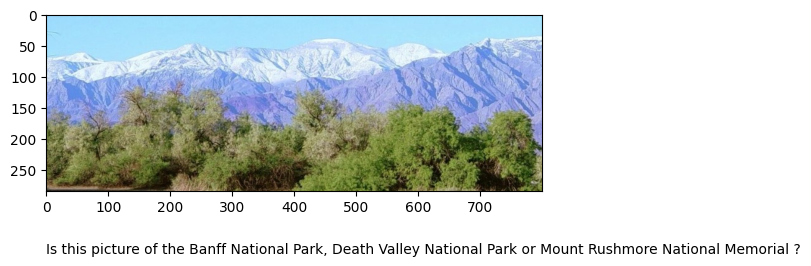

landmark_images\test\42.Death_Valley_National_Park\5a4dca33b5a8b74f.jpg
50


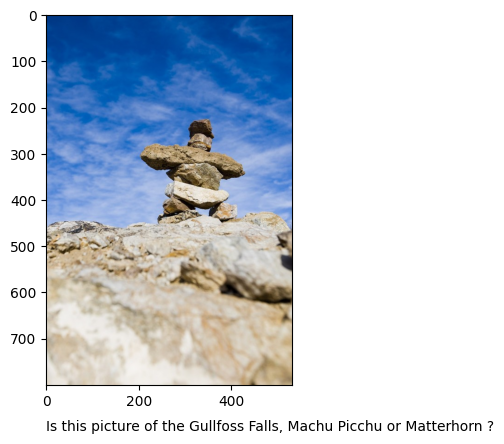

landmark_images\test\43.Gullfoss_Falls\1ebc2ece28e1cbad.jpg
50


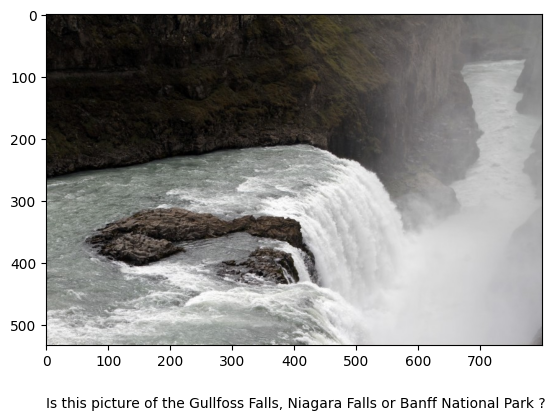

landmark_images\test\43.Gullfoss_Falls\5c1d0b53fce01610.jpg
50


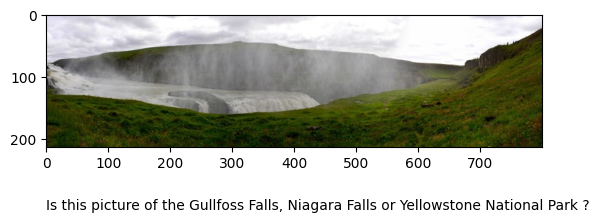

landmark_images\test\44.Trevi_Fountain\097ff54ab4271a6f.jpg
50


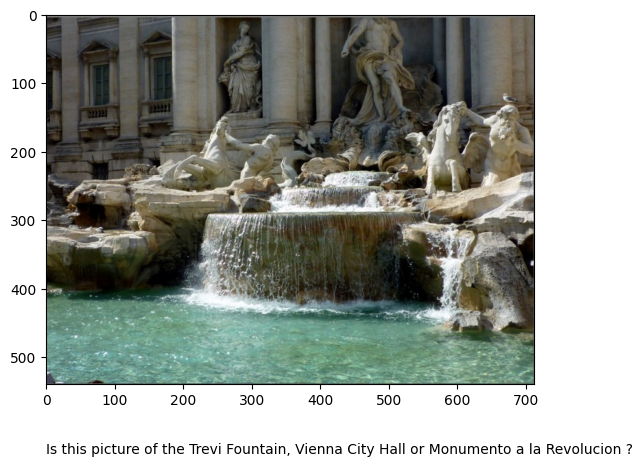

landmark_images\test\44.Trevi_Fountain\41c52ea1d3b7593a.jpg
50


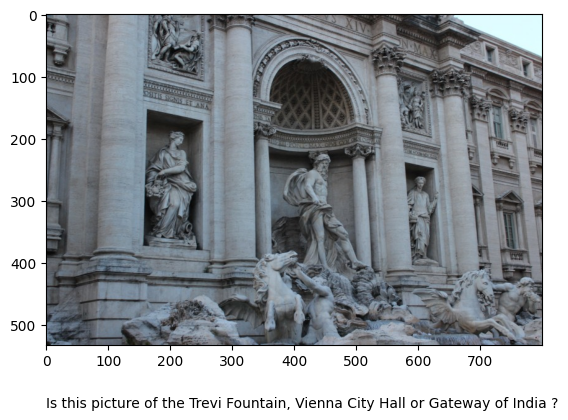

landmark_images\test\44.Trevi_Fountain\791981db7256a47d.jpg
50


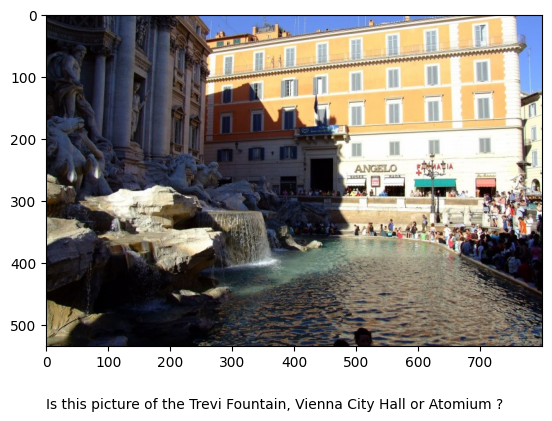

landmark_images\test\45.Temple_of_Heaven\2af4218fe2a1f900.jpg
50


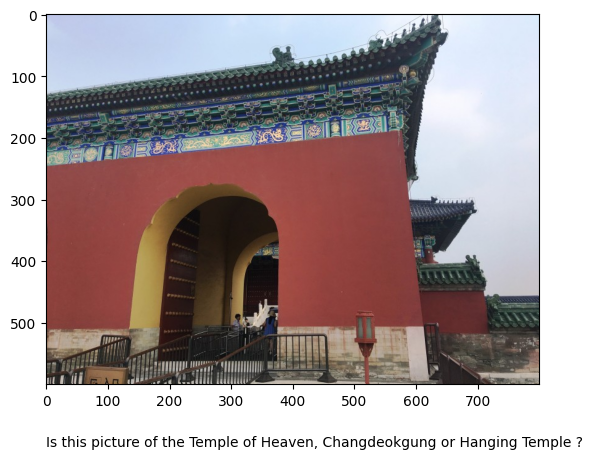

landmark_images\test\45.Temple_of_Heaven\6356845282dfcde3.jpg
50


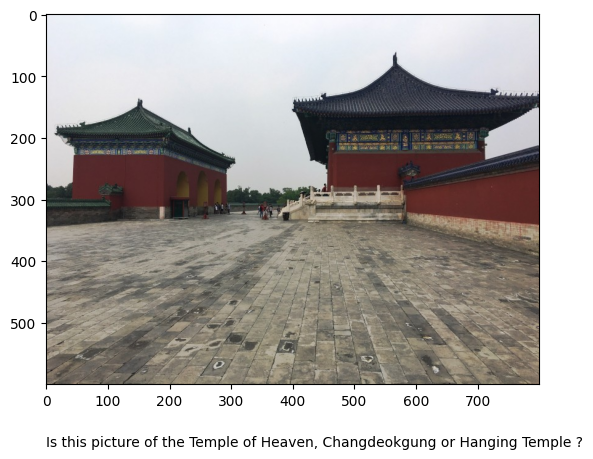

landmark_images\test\46.Great_Wall_of_China\25e08232feee7ea3.jpg
50


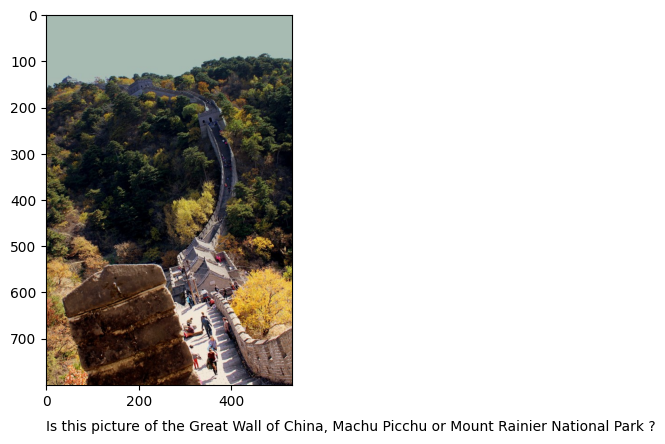

landmark_images\test\46.Great_Wall_of_China\4a7209de41431e9b.jpg
50


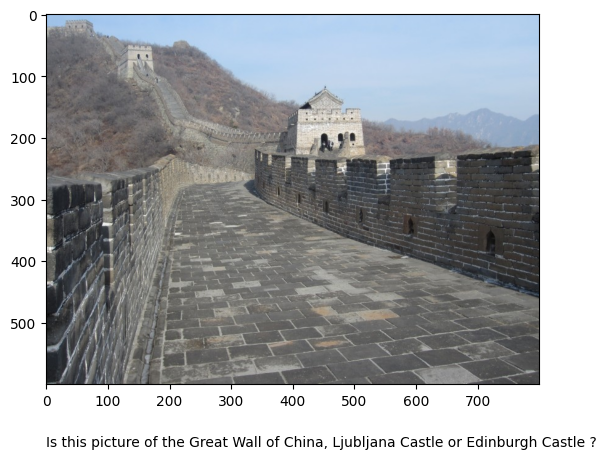

landmark_images\test\47.Prague_Astronomical_Clock\0fcdf206e1e36f05.jpg
50


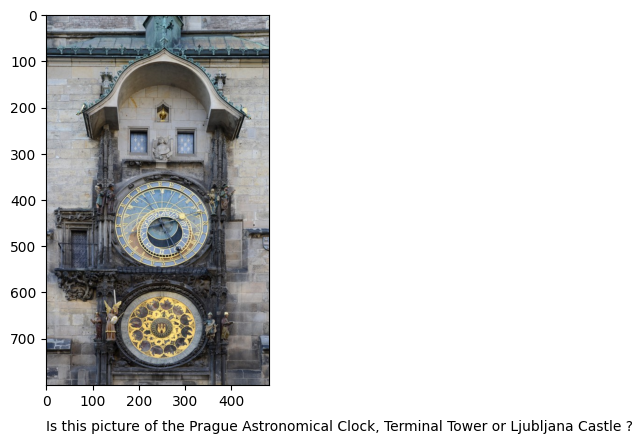

landmark_images\test\47.Prague_Astronomical_Clock\59f46ae80330519f.jpg
50


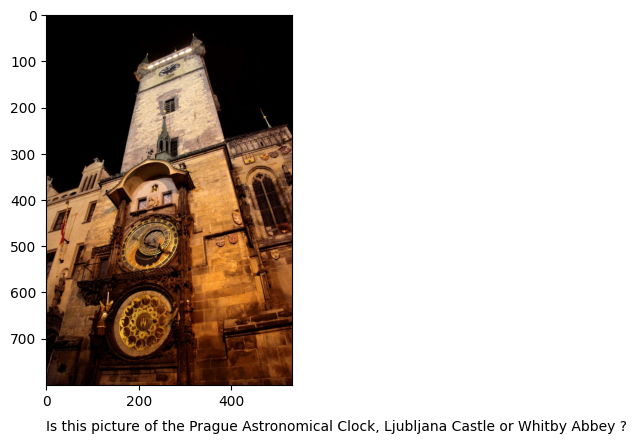

landmark_images\test\47.Prague_Astronomical_Clock\7d807d38b49395bb.jpg
50


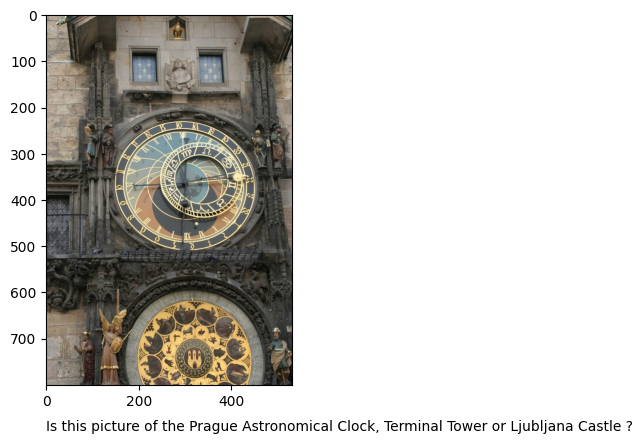

landmark_images\test\48.Whitby_Abbey\376e025c0da1b4b6.jpg
50


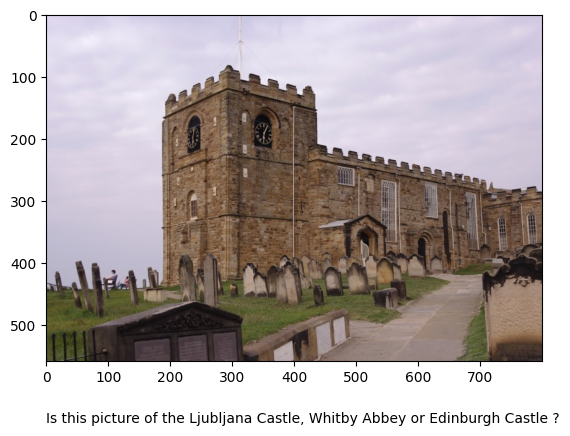

landmark_images\test\48.Whitby_Abbey\75dc03b37fea0ae4.jpg
50


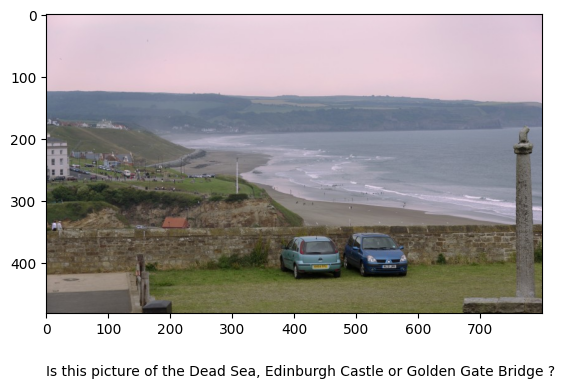

landmark_images\test\49.Temple_of_Olympian_Zeus\34aa0fbd65529602.jpg
50


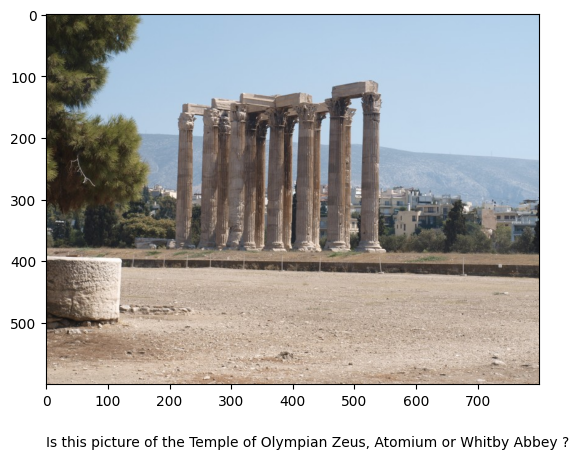

landmark_images\test\49.Temple_of_Olympian_Zeus\5eaecfb5d906417b.jpg
50


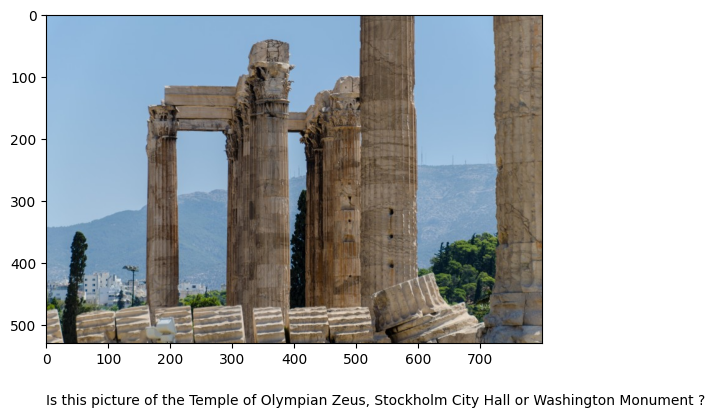

In [29]:
## TODO: Execute the `suggest_locations` function on
## at least 4 images on your computer.
## Feel free to use as many code cells as needed.
import os
root = Path('landmark_images/test')
dirs = [x for x in root.iterdir() if x.is_dir()]
images = []
for i in dirs:
    images.extend([x for x in i.iterdir() if x.is_file()])
for i in range(0,len(images),11):
    print(images[i])
    suggest_locations(images[i])